# Imports

In [8]:
# Imports
from IPython.display import display, HTML
import string

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import plotly.graph_objects as go
import chart_studio.plotly as py
import plotly.express as px
%matplotlib inline

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
from wordcloud import WordCloud

import sklearn


import bs4
import re

# Set seaborn style
sns.set_style("whitegrid")

# Increase the width of the notebook for displaying DataFrames
display(HTML("<style>.container { width:75% !important; }</style>"))

In [9]:
import cufflinks as cf
cf.go_offline()

In [10]:
import statsmodels.api as sm
from statsmodels.tsa.seasonal import seasonal_decompose

from gensim.models import TfidfModel
from gensim.corpora import Dictionary
from gensim.models import LdaModel

In [11]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

In [12]:
import nltk
from nltk import word_tokenize, wordpunct_tokenize, pos_tag
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

stop_words = stopwords.words("english")
from nltk.stem import PorterStemmer, WordNetLemmatizer
from nltk.corpus import wordnet
nltk.download('punkt') #Run this line one time to get the resource
nltk.download('stopwords') #Run this line one time to get the resource
nltk.download('wordnet') #Run this line one time to get the resource
nltk.download('averaged_perceptron_tagger') #Run this line one time to get the resource

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Madi\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Madi\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Madi\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\Madi\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [13]:
stemmer = nltk.stem.PorterStemmer()
lemmatizer = nltk.stem.WordNetLemmatizer()


def clean_data(quote):
    soup = bs4.BeautifulSoup(quote, features="html.parser")
    #quote = re.sub("<.*?>|nbsp", "", quote)
    for script in soup(["script", "style"]):
        script.extract()

    quote = soup.get_text(separator=" ")
    quote = quote.lower()
    tokens = word_tokenize(quote)
    token_punc = [t for t in tokens if t.isalpha()]
    token_stop = [t for t in token_punc if t not in stop_words]
    stemmed_words = [stemmer.stem(w) for w in token_stop]
    return ' '.join(stemmed_words)

___
_**Read data from preprocessed data csv**_
___

In [14]:
df = pd.read_csv('preprocessed_data.csv')
df["Date"] = pd.to_datetime(df["Date"])

C:\Users\Madi\AppData\Local\Temp\ipykernel_3180\262885538.py:1: DtypeWarning:

Columns (5,6,7,8) have mixed types. Specify dtype option on import or set low_memory=False.



In [15]:
df.head(5)

,Unnamed: 0,Id,Title,Company,Date,Location,Area,Classification,SubClassification,Requirement,FullDescription,LowestSalary,HighestSalary,JobType,AverageSalary
0,0,37404348,Casual Stock Replenisher,Aldi Stores,2018-10-07,Sydney,North West & Hills District,Retail & Consumer Products,Retail Assistants,Our Casual Stock Replenishers pride themselves...,NaN,0,30,NaN,15.0
1,1,37404337,Casual Stock Replenisher,Aldi Stores,2018-10-07,Richmond & Hawkesbury,NaN,Retail & Consumer Products,Retail Assistants,Our Casual Stock Replenishers pride themselves...,NaN,0,30,NaN,15.0
2,2,37404356,RETAIL SALES SUPERSTARS and STYLISTS Wanted - ...,LB Creative Pty Ltd,2018-10-07,Brisbane,CBD & Inner Suburbs,Retail & Consumer Products,Retail Assistants,BRAND NEW FLAGSHIP STORE OPENING - SUNSHINE PLAZA,NaN,0,30,NaN,15.0
3,3,37404330,Team member - Belrose,Anaconda Group Pty Ltd,2018-10-07,Gosford & Central Coast,NaN,Retail & Consumer Products,Retail Assistants,Bring it on - do you love the great outdoors a...,NaN,0,30,NaN,15.0
4,4,37404308,"Business Banking Contact Centre Specialist, Ni...",Commonwealth Bank - Business & Private Banking,2018-10-07,Sydney,Ryde & Macquarie Park,Call Centre & Customer Service,Sales - Inbound,"We are seeking highly articulate, enthusiastic...",NaN,0,30,NaN,15.0


___
# **PART 2 - Data Analysis and Interpretation**
___

# 1) Studying Job Metadata
___

In [16]:
colors = ['#1F77B4', '#AEC7E8', '#FF7F0E', '#FFBB78', '#2CA02C', '#98DF8A', '#B5CF6B', '#FF9896','#9467BD', '#C5B0D5', '#BCBD22']

_Creating ```averageSalaryDf```_

In [17]:
# Group by average salary and count the numbers
averageSalaryDf = df.groupby('AverageSalary').count()
averageSalaryDf['AverageSalary'] = (averageSalaryDf.index*1000).astype(float).map('{:,.0f}'.format)
averageSalaryDf['Count'] = averageSalaryDf['Id']
averageSalaryDf

,Unnamed: 0,Id,Title,Company,Date,Location,Area,Classification,SubClassification,Requirement,FullDescription,LowestSalary,HighestSalary,JobType,AverageSalary,Count
AverageSalary,,,,,,,,,,,,,,,,
15.0,62639,62639,62639,59611,62639,38541,24399,38541,38541,62637,56065,62639,62639,56080,"15,000",62639
35.0,23476,23476,23476,22296,23476,16396,9811,16396,16396,23476,22092,23476,23476,22094,"35,000",23476
45.0,34436,34436,34436,32076,34436,21736,13264,21736,21736,34435,33580,34436,34436,33585,"45,000",34436
55.0,27027,27027,27027,25679,27027,16561,10755,16561,16561,27026,26206,27027,27027,26222,"55,000",27027
65.0,28499,28499,28499,27290,28499,18121,11393,18121,18121,28499,27544,28499,28499,27566,"65,000",28499
75.0,28712,28712,28712,27794,28712,17053,10456,17053,17053,28712,27670,28712,28712,27674,"75,000",28712
90.0,24249,24249,24249,23625,24249,12701,7562,12701,12701,24248,23587,24249,24249,23590,"90,000",24249
110.0,27673,27673,27673,27150,27673,17137,10575,17137,17137,27671,26682,27673,27673,26683,"110,000",27673
135.0,24514,24514,24514,24165,24514,14701,9481,14701,14701,24514,23610,24514,24514,23612,"135,000",24514


_Plotting correlations between “AverageSalary” and the Total Jobs of each range_

C:\Users\Madi\AppData\Local\Temp\ipykernel_3180\215919579.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




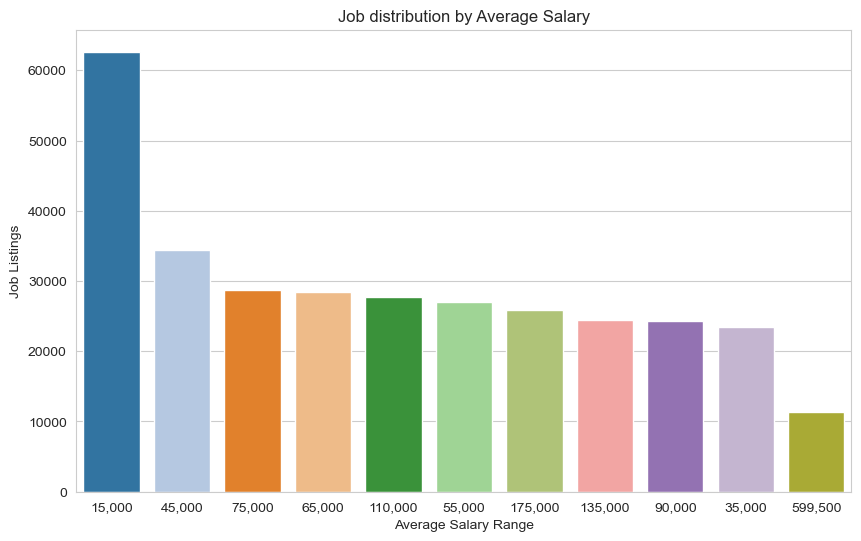

In [18]:
averageSalaryDfOrdered = averageSalaryDf.sort_values('Count', ascending=False)
plt.figure(figsize=(10,6)) 
sns.barplot(
    data=averageSalaryDfOrdered, 
    x='AverageSalary', 
    y='Count', 
    palette=colors
)
plt.title("Job distribution by Average Salary")
plt.xlabel("Average Salary Range")
plt.ylabel("Job Listings")
plt.show()

_Plotting distribution between job types_

In [19]:
jobTypeDf = df.groupby('JobType').count()
jobTypeDf['Count'] = jobTypeDf['Id']
jobTypeDf['JobType'] = jobTypeDf.index

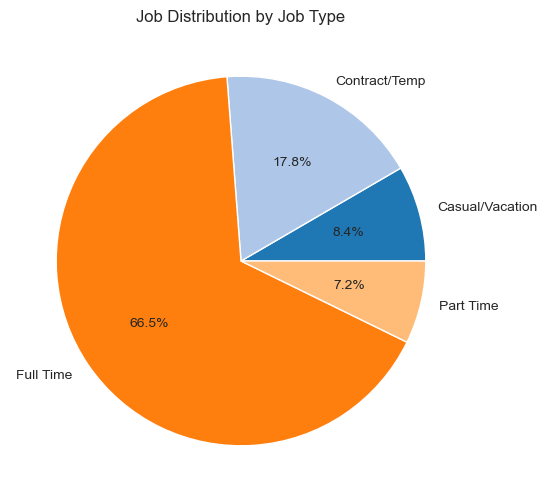

In [20]:
plt.figure(figsize=(6,6))
plt.title("Job Distribution by Job Type")
plt.pie(
    jobTypeDf['Count'], 
    labels=jobTypeDf['JobType'], 
    autopct='%1.1f%%',
    colors=colors
)
plt.show()

_Plotting correlation between job type and average salary_

In [22]:
series = []
for jobType in jobTypeDf.index:
    series.append(df[df["JobType"] == jobType]["AverageSalary"].mean())

jobTypeDf["AverageSalary"] = series

C:\Users\Madi\AppData\Local\Temp\ipykernel_3180\1142535061.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


C:\Users\Madi\AppData\Local\Temp\ipykernel_3180\1142535061.py:2: UserWarning:

The palette list has more values (11) than needed (4), which may not be intended.



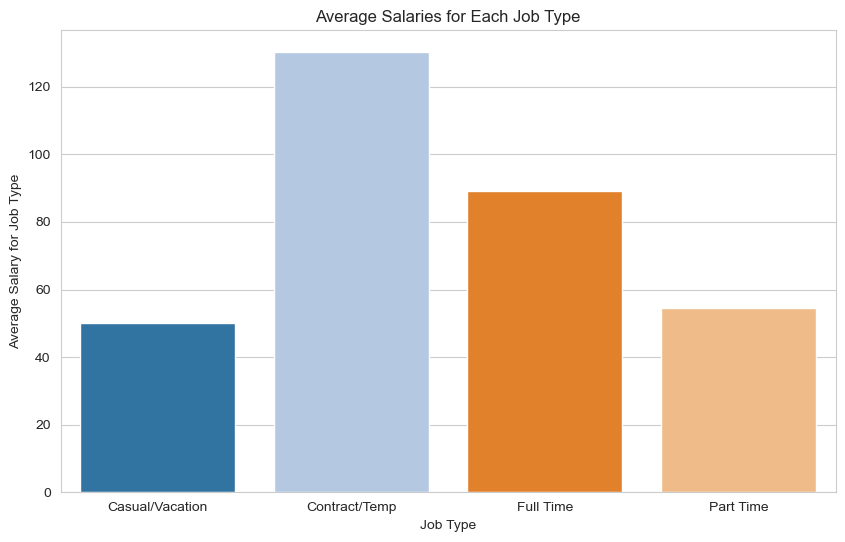

In [26]:
plt.figure(figsize=(10,6))
sns.barplot(
    data=jobTypeDf, 
    x='JobType', 
    y='AverageSalary',
    palette=colors
)

plt.xlabel('Job Type')
plt.ylabel("Average Salary for Job Type")
plt.title("Average Salaries for Each Job Type")
plt.show()

*Plotting by companies*

In [103]:
companyDf = df.groupby('Company').count()
companyDf['Count'] = companyDf["Id"]
companyDf['Company'] = companyDf.index
companyDf = companyDf.sort_values(ascending=False, by='Count')
companyDf.head(5)

,Unnamed: 0,Id,Title,Date,Location,Area,Classification,SubClassification,Requirement,FullDescription,LowestSalary,HighestSalary,JobType,AverageSalary,Count,Company
Company,,,,,,,,,,,,,,,,
Jora Local,9354,9354,9354,9354,6570,4784,6570,6570,9354,8287,9354,9354,8287,9354,9354,Jora Local
Hudson,1668,1668,1668,1668,1114,594,1114,1114,1668,1610,1668,1668,1610,1668,1668,Hudson
Design & Build,1547,1547,1547,1547,1038,738,1038,1038,1547,1486,1547,1547,1486,1547,1547,Design & Build
Robert Walters,1385,1385,1385,1385,901,682,901,901,1385,1264,1385,1385,1264,1385,1385,Robert Walters
Paxus,1325,1325,1325,1325,929,490,929,929,1325,1113,1325,1325,1113,1325,1325,Paxus


c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead



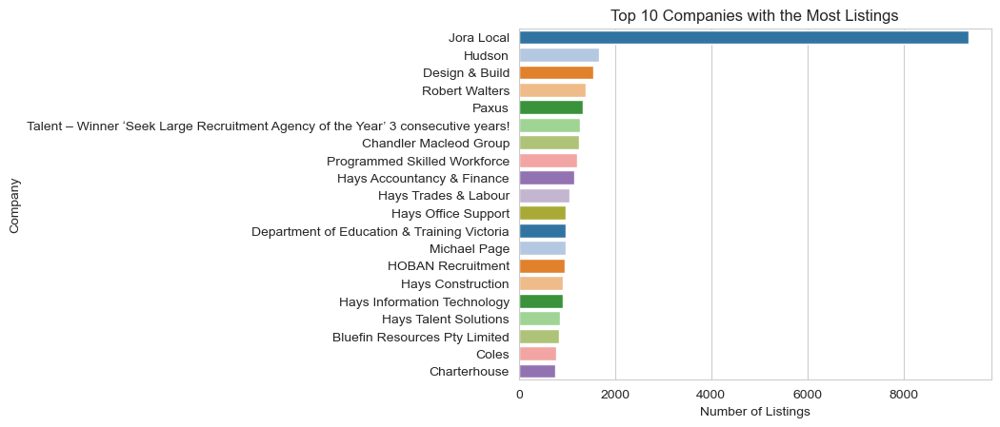

In [104]:
sns.barplot(
    data=companyDf, 
    x='Count', 
    y='Company', 
    palette=colors, 
    order=companyDf["Company"][:20]
)
plt.xlabel("Number of Listings")
plt.title("Top 10 Companies with the Most Listings")
plt.show()

### __ANALYSIS__

The job distribution by average salary is displayed in an above bar chart. A notable insight is that by far the most jobs available are seen in the $30,000 range. This suggests a large amount of listings could be either unskilled labour, part time work, or potentially both. The second most common salary offered was in the $90,000 range. The least commonly advertised salary was for the $1,199,000 range. This range had approximately 2000 less listings than the second-least advertised salary range of $110,000.

Over 60% of jobs listed were full time, with part time being the least popular job offering at only 7%. Casual jobs were more popular than part time, but less popular than contract work. This shows the market has a preference to full-time availability. The most high paid job type was Contract/Temp which had average salaries greater than $120k, which is over $30k more than the second highest paid job type of full time. Contract/temp had higher salaries than full time, but only made up 17.8% of listings.

The most popular company offering listings was by far Jora Local, which advertises itself as a product which is catered to helping small businesses with the hiring process. This indicates a large portion of ads are potentially for small businesses.  Many of the companies on this list are from recruitment agencies for trades and IT, suggesting a high demand for workers within those sectors. This could be a reason for the second most popular average salary being relatively high, as potentially a large amount of listings are for skilled work.

___
# 2) Study market by locations
___
In this section analysis will be used to study the data in regards to locations

In [105]:
locationDf = df[df['Location'].isna()==False]
locationDf = locationDf.groupby('Location').count()
locationDf['Location'] = locationDf.index
locationDf['Count'] = locationDf["Id"]
locationDf.head(5)

,Unnamed: 0,Id,Title,Company,Date,Area,Classification,SubClassification,Requirement,FullDescription,LowestSalary,HighestSalary,JobType,AverageSalary,Location,Count
Location,,,,,,,,,,,,,,,,
ACT,6250,6250,6250,6150,6250,0,6250,6250,6250,5805,6250,6250,5807,6250,ACT,6250
Adelaide,6653,6653,6653,6303,6653,0,6653,6653,6653,6312,6653,6653,6313,6653,Adelaide,6653
Adelaide Hills & Barossa,193,193,193,186,193,0,193,193,193,182,193,193,182,193,Adelaide Hills & Barossa,193
Albany & Great Southern,150,150,150,149,150,0,150,150,150,134,150,150,134,150,Albany & Great Southern,150
Albury Area,416,416,416,404,416,0,416,416,416,407,416,416,407,416,Albury Area,416


_Getting top 20 big cities and using bar chart to display market size in each city_

In [106]:
locationDf = locationDf.sort_values(by="Count", ascending=False)

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead



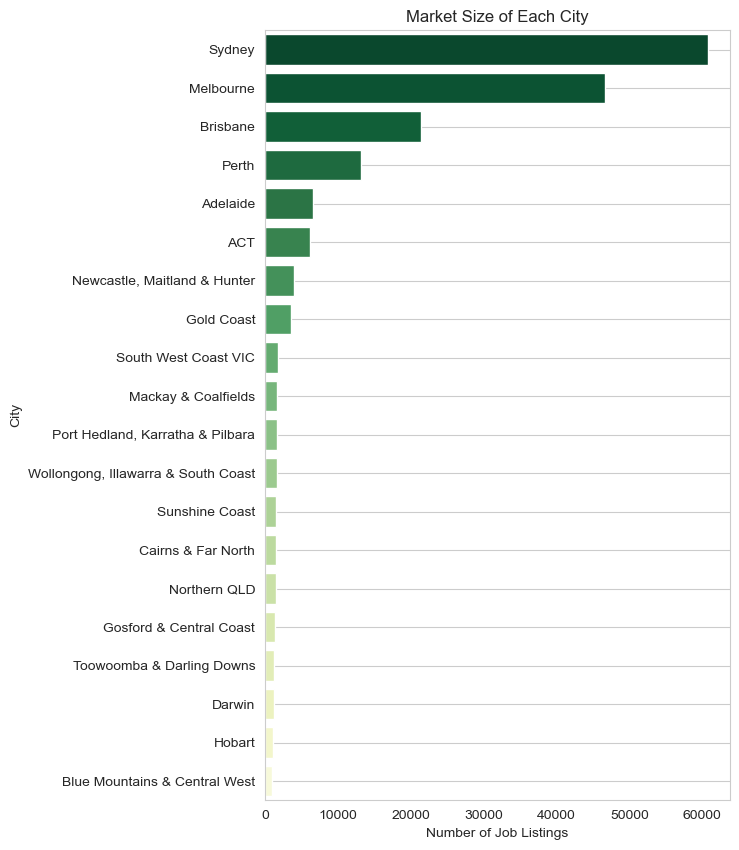

In [107]:
plt.figure(figsize=(6,10)) 
sns.barplot(
    data=locationDf, 
    x='Count', 
    y='Location', 
    palette="YlGn_r", 
    order=locationDf["Location"][:20]
)
plt.grid()
plt.xlabel("Number of Job Listings")
plt.ylabel("City")
plt.title("Market Size of Each City")
plt.show()

_Visualizing the market share between the cities_

In [108]:
#Get top 10 big cities
locationTop10Df = locationDf[:10].copy()

#others
new_row = pd.DataFrame(data = {
    'Location' : ['Others'],
    'Count' : [locationDf["Count"][10:].sum()]
})
locationTop10Df = pd.concat([locationTop10Df, new_row],sort=False)
locationTop10Df.index = locationTop10Df['Location']

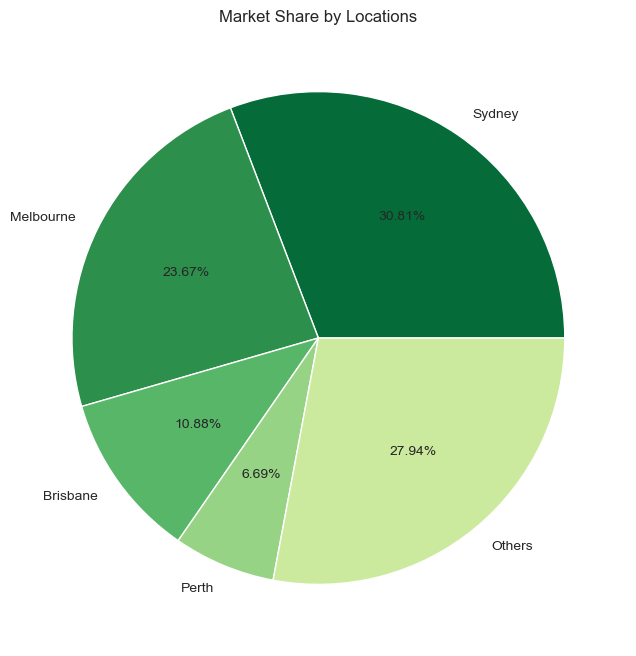

In [109]:
topX = 4

locationTopXDf = locationDf[:topX].copy()

#others
new_row = pd.DataFrame(data = {
    'Location' : ['Others'],
    'Count' : [locationDf["Count"][topX:].sum()]
})
locationTopXDf = pd.concat([locationTopXDf, new_row],sort=False)
locationTopXDf.index = locationTopXDf['Location']

sns.set_palette("YlGn_r")
plt.figure(figsize=(8,8))
plt.title("Market Share by Locations")
plt.pie(
    locationTopXDf['Count'], 
    labels=locationTopXDf['Location'], 
    autopct='%1.2f%%'
)
plt.show()

_Visualizing the salary distribution in top biggest cities_

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead



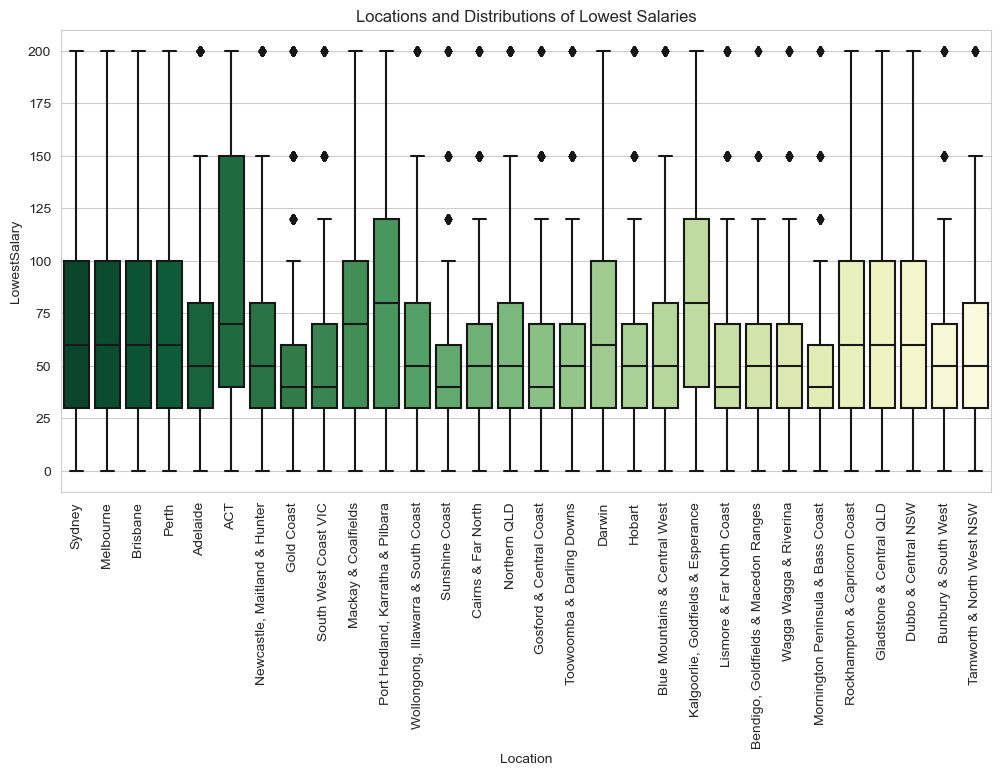

In [110]:
plt.figure(figsize=(12,6))
sns.boxplot(
    data=df,
    x='Location',
    y='LowestSalary',
    palette=sns.color_palette('YlGn_r',n_colors=30),
    order=locationDf['Location'][:30]
)
plt.xticks(rotation=90)
plt.title("Locations and Distributions of Lowest Salaries")
plt.show()

_Displaying the largest sector in the top biggest cities_

In [111]:
biggestSectorDf = pd.DataFrame(columns=["Location", "Biggest Sector"])
biggestSectorDf["Location"] = locationDf["Location"]
biggestSectorDf.index = biggestSectorDf["Location"]
biggestSectorArray = []

for Location in biggestSectorDf["Location"]:
    biggestSectorArray.append(df[df["Location"] == Location].value_counts("Classification", ascending=False).index[0])

biggestSectorDf["Biggest Sector"] = biggestSectorArray
biggestSectorDf.head(10)

,Location,Biggest Sector
Location,,
Sydney,Sydney,Information & Communication Technology
Melbourne,Melbourne,Information & Communication Technology
Brisbane,Brisbane,Information & Communication Technology
Perth,Perth,Trades & Services
Adelaide,Adelaide,Trades & Services
ACT,ACT,Information & Communication Technology
"Newcastle, Maitland & Hunter","Newcastle, Maitland & Hunter",Trades & Services
Gold Coast,Gold Coast,Hospitality & Tourism
South West Coast VIC,South West Coast VIC,Hospitality & Tourism


**ANALYSIS**


We can see from the table above that "It" is the biggest sector in cities that are classed as "Urban", however more "Rural" cities such as Perth we see that Trades & Services become the biggest sector.

In [112]:
sector_city_counts = biggestSectorDf.groupby('Biggest Sector')['Location'].nunique()
sector_city_counts

# Create a new DataFrame for plotting
plot_df = sector_city_counts.reset_index()
plot_df.columns = ['Biggest Sector', 'City Count']
# Define the color palette
color_palette = px.colors.sequential.YlGn_r

# Create the pie chart
fig = px.pie(plot_df, values='City Count', names='Biggest Sector', 
             title='Number of Cities by Biggest Sector',
             hover_data={'City Count': True},
             labels={'City Count': 'Number of Cities'},
             color_discrete_sequence=color_palette)

# Update the hover info to show city count
fig.update_traces(textinfo='percent+label', hovertemplate='%{label}<br>Number of Cities: %{value}')

# Show the figure
fig.show()


In [113]:
it_cities = biggestSectorDf[biggestSectorDf['Biggest Sector'] == 'Information & Communication Technology']
it_cities

,Location,Biggest Sector
Location,,
Sydney,Sydney,Information & Communication Technology
Melbourne,Melbourne,Information & Communication Technology
Brisbane,Brisbane,Information & Communication Technology
ACT,ACT,Information & Communication Technology


_Displaying the largest sectors in the biggest cities_

In [114]:
act_sect_df = df[df['Location'] == 'ACT']
act_sect_df = act_sect_df['Classification'].dropna().value_counts().reset_index()
act_sect_df.columns = ['Classification', 'Count']
print('ACT:')
print(act_sect_df.head())

adl_sect_df = df[df['Location'] == 'Adelaide']
adl_sect_df = adl_sect_df['Classification'].dropna().value_counts().reset_index()
adl_sect_df.columns = ['Classification', 'Count']
print('Adelaide:')
print(adl_sect_df.head())


syd_sect_df = df[df['Location'] == 'Sydney']
syd_sect_df = syd_sect_df['Classification'].dropna().value_counts().reset_index()
syd_sect_df.columns = ['Classification', 'Count']
print('Sydney:')
print(syd_sect_df.head())

ACT:
                           Classification  Count
0  Information & Communication Technology   2057
1                    Government & Defence    606
2                    Healthcare & Medical    375
3                       Trades & Services    367
4                   Hospitality & Tourism    326
Adelaide:
                           Classification  Count
0                       Trades & Services    819
1                    Healthcare & Medical    786
2    Manufacturing, Transport & Logistics    550
3  Information & Communication Technology    547
4                   Hospitality & Tourism    499
Sydney:
                           Classification  Count
0  Information & Communication Technology   9548
1                   Hospitality & Tourism   4074
2                       Trades & Services   4026
3                              Accounting   4010
4                    Healthcare & Medical   3339


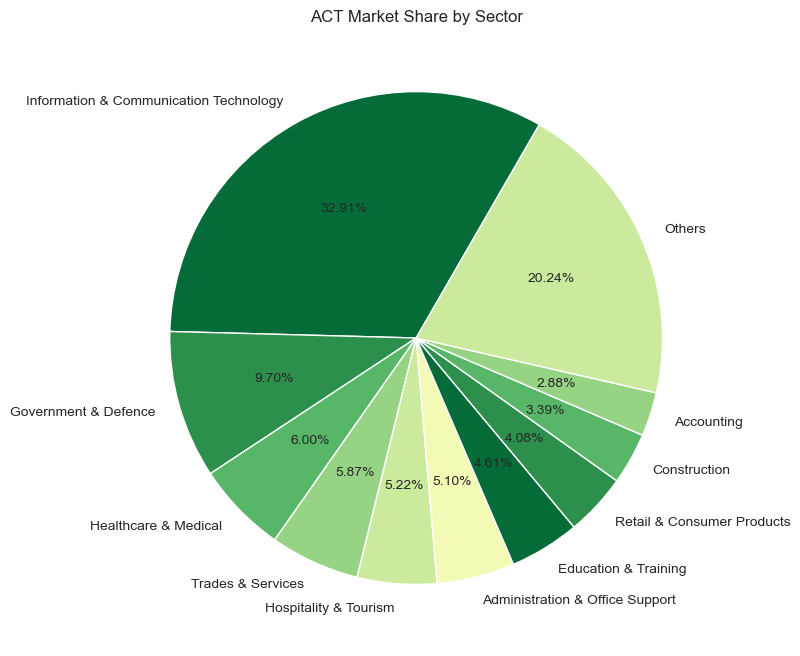

In [115]:
#fig, axes = plt.subplots(1, 2, figsize=(14,6))
#plt.pie(act_sector_counts, labels=act_sector_counts.index, autopct='%1.1f%')
#plt.set_title("ACT Market Share of Sectors")
"""
axes[1].pie(adelaide_sector_counts, labels=adelaide_sector_counts.index, autopct='%1.1f%')
axes[1].set_title("Adelaide Market Share of Sectors")
"""
topX = 10
act_new = act_sect_df[:topX].copy()

new_row = pd.DataFrame(data = {
    'Classification' : ['Others'],
    'Count' : [act_sect_df["Count"][topX:].sum()]
})
act_new = pd.concat([act_new, new_row],sort=False)
act_new.index = act_new['Classification']

sns.set_palette("YlGn_r")
plt.figure(figsize=(8,8))
plt.title("ACT Market Share by Sector")
plt.pie(
    act_new['Count'], 
    labels=act_new['Classification'], 
    autopct='%1.2f%%',
    startangle=60
)
plt.show()

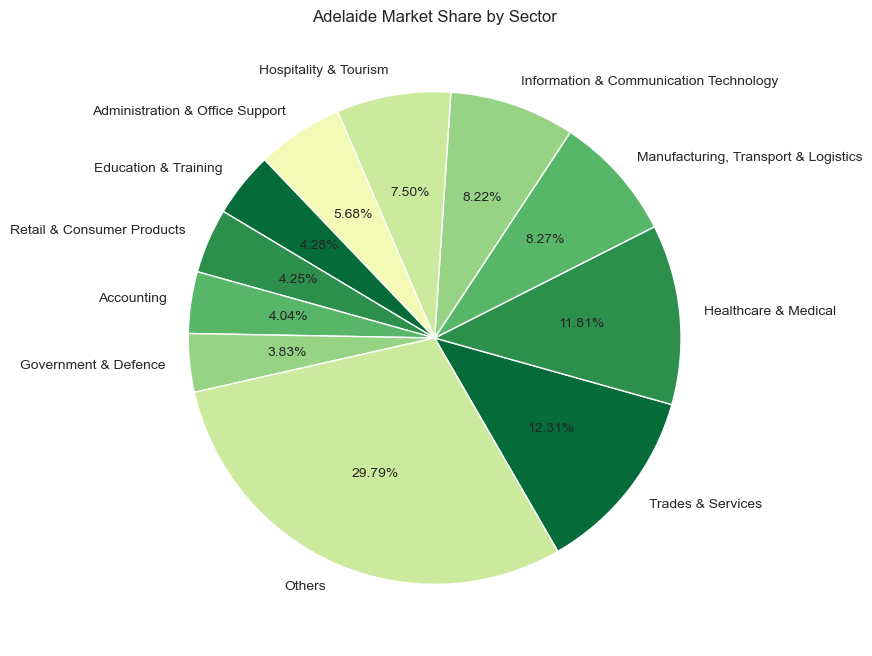

In [116]:
topX = 10
adl_new = adl_sect_df[:topX].copy()

new_row = pd.DataFrame(data = {
    'Classification' : ['Others'],
    'Count' : [adl_sect_df["Count"][topX:].sum()]
})
adl_new = pd.concat([adl_new, new_row],sort=False)
adl_new.index = adl_new['Classification']

sns.set_palette("YlGn_r")
plt.figure(figsize=(8,8))
plt.title("Adelaide Market Share by Sector")
plt.pie(
    adl_new['Count'], 
    labels=adl_new['Classification'], 
    autopct='%1.2f%%',
    startangle=-60
)
plt.show()

### **ANALYSIS**

From the location data it can be seen that Sydney, Melbourne, Brisbane, Perth and Adelaide are the cities with the largest market sizes. The other capitol cities Darwin and Hobart fall much lower on the market share comparison, ranking 18th and 19th respectively. ACT was just behind Adelaide as the 6th biggest job market. 30.81% of all listings are for Sydney, which makes its market share larger than all cities ranking lower than top 5 combined, which have a total share of 27.94%.

ICT was the biggest sector in Sydney, Melbourne and Brisbane and was the most represented sector in the top 10 locations with respect to market size. The second most represented sector in the top 10 was Trades & Services, being the largest sector in Perth, Adelaide, and Newcastle, Maitland & Hunter Valley. Hospitality & Tourism was the most popular in Gold Coast and South West Coast, and Mining Resources & Energy was only represented once in the top 10 list, being the largest sector in Mackay & Coalfields.

The distribution of sectors demonstrates a correlation between the city size and its main industry, with large cities having mostly ICT jobs, mid-sized cities advertising mostly for Trades & Services, and tourist locations mostly advertising for hospitality. Mackay & Coalfields is known predominately for its mining industry, which explains it as an outlier by representing the Mining, Resources & Energy sector.

It appears that the distributions of lowest salaries was very similar between Sydney, Melbourne, Bisbane and Perth, but ACT had a much higher salary for the upper quartile and its median was around $10,000 higher than the other cities. Adelaide on the other hand had a smaller spread, with a median lower by roughly $10,000 and an upper quartile that was lower than Sydney, Melbourne, Brisbane and Perth by roughly $20,000. Additionally, Adelaide had the lowest upper bound ($150,000) when compared to Sydney, Melbourne, Brisbane, Perth and Adelaide which all had upper bounds of $200,000. From these statistics it can be shown that ACT has the highest skewed lowest advertised salaries for the most amount of jobs listed. 

Adelaide and the ACT have a very similar market size, but very different lowest salary distributions. Adelaide's biggest sector is Trades & Services, where the ACT's biggest sector is Information & Communication Technology. This indicates Adelaide's lower salaries could be linked to the salaries of the Trades & Services sector in general when compared to the ICT sector, though Perth offers itself as a counter example, having similar salary distributions to Sydney, Melbourne and Brisbane, yet being the only of the 4 to have Trades & Services as its largest sector. Perth's market size is almost double the size of Adelaide's and the ACT's, suggesting that the market size could be an influencing factor of salaries alongside the biggest sector of that city.

The regions Port Hedland, Karratha & Pilbara and Kalgoorlie, Goldfields & Esperance stood out as outliers for the lowest salary distributions, as they sckewed higher than Sydney, Melbourne, Brisbane and Perth but are not even represented in the bar chart of the top 20 market sizes.

*Time Series Analysis*

In [117]:
dayDf = pd.DataFrame(data=pd.to_datetime(df["Date"]))
dayDf["DayofMonth"] = dayDf["Date"].apply(lambda x: x.day)
dayOfMonth = dayDf["DayofMonth"].value_counts()
dayDf["DayofWeek"] = dayDf["Date"].apply(lambda x: x.dayofweek)
dayOfWeek = dayDf["DayofWeek"].value_counts().sort_index()
dayDf["Week"] = dayDf["Date"].apply(lambda x: x.week)
Week = dayDf["Week"].value_counts()
dayDf["Month"] = dayDf["Date"].apply(lambda x: x.month)
Month = dayDf["Month"].value_counts().sort_index()

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead



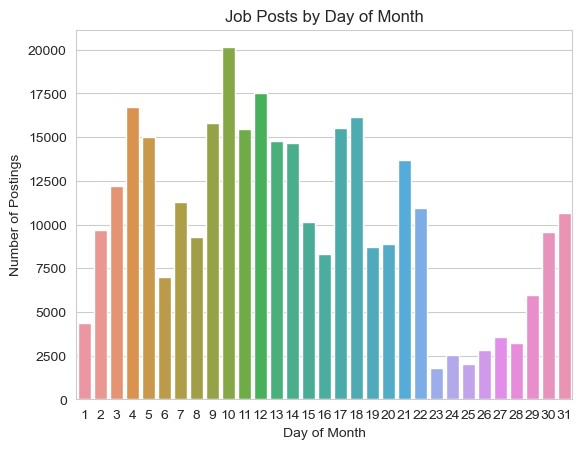

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead



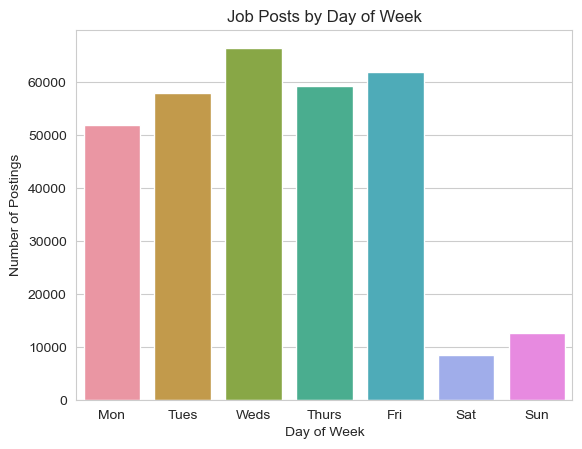

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead



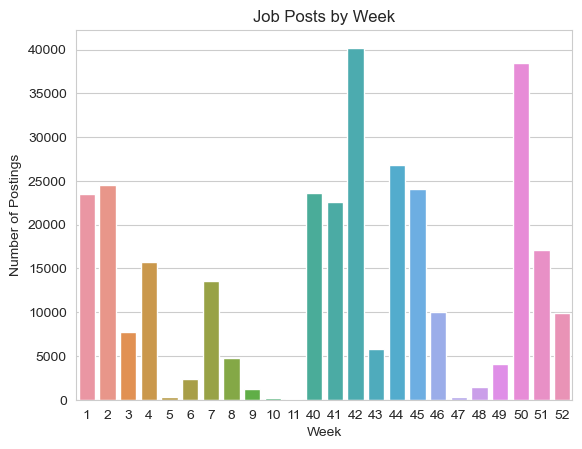

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead



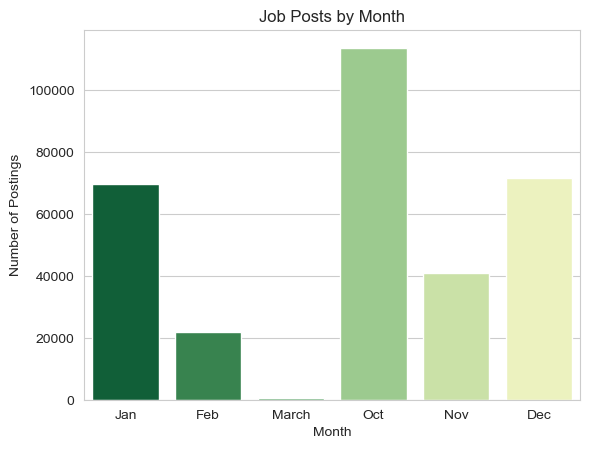

In [118]:
sns.barplot(x=dayOfMonth.index, y=dayOfMonth.values)
plt.title("Job Posts by Day of Month")
plt.xlabel("Day of Month")
plt.ylabel("Number of Postings")
plt.show()
sns.barplot(x=pd.array(["Mon", "Tues", "Weds", "Thurs", "Fri", "Sat", "Sun"]), y=dayOfWeek.values)
plt.title("Job Posts by Day of Week")
plt.xlabel("Day of Week")
plt.ylabel("Number of Postings")
plt.show()
sns.barplot(x=Week.index, y=Week.values)
plt.title("Job Posts by Week")
plt.xlabel("Week")
plt.ylabel("Number of Postings")
plt.show()
sns.barplot(x=np.array(["Jan", "Feb", "March", "Oct", "Nov", "Dec"]), y=Month.values)
plt.title("Job Posts by Month")
plt.xlabel("Month")
plt.xticks()
plt.ylabel("Number of Postings")
plt.show()

In [119]:
dayDf = df.groupby(by="Date").count()
dayDf.index = pd.to_datetime(dayDf.index)
dayDf["Count"] = dayDf["Id"]
dayDf["WeekMoving"] = dayDf["Count"].rolling(7, min_periods=0).mean()
dayDf["MonthMoving"] = dayDf["Count"].rolling(30, min_periods=0).mean()

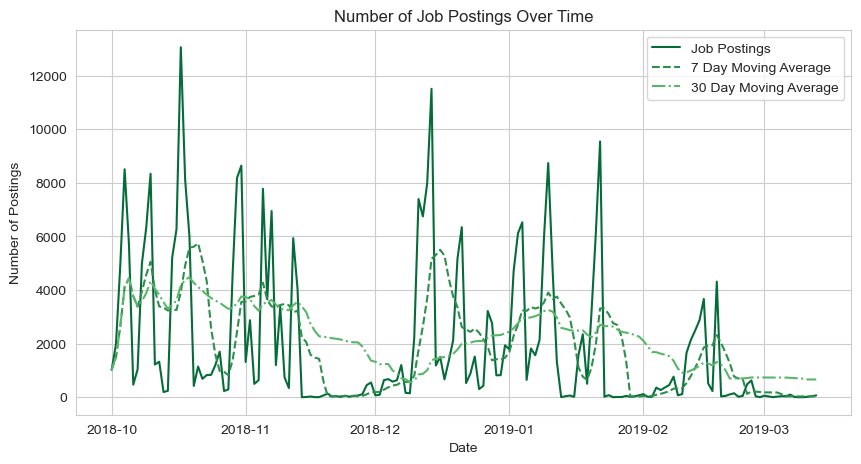

In [120]:
plt.figure(figsize=(10,5))
plt.plot(dayDf["Count"])
plt.plot(dayDf["WeekMoving"], linestyle="--")
plt.plot(dayDf["MonthMoving"], linestyle="-.")
plt.legend(["Job Postings", "7 Day Moving Average", "30 Day Moving Average"])
plt.xlabel("Date")
plt.ylabel("Number of Postings")
plt.title("Number of Job Postings Over Time")
plt.show()

## **ANALYSIS (includes predictive analysis)**
From the moving average we can see a general downward slope over time, this is most likley due to the data becoming closer to the holiday period. We can see at the end a slight upwards curve indicating that the amount of postings should increase. Without atleaset 1 year of data it is hard to predict what is truly going to happen and is impossible to extract seasonailty over a years period.

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\3114353963.py:9: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\3114353963.py:9: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\3114353963.py:9: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\3114353963.py:9: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\3114353963.py:9: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



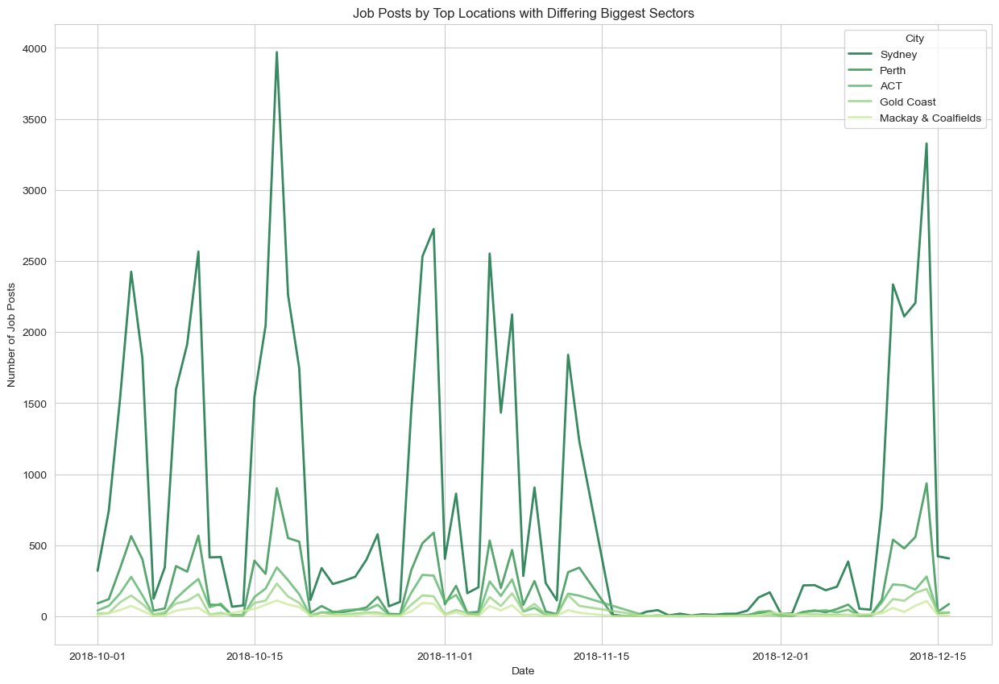

In [121]:
loc_time_df = df.copy()
loc_time_df['Date'] = pd.to_datetime(loc_time_df['Date'])
loc_time_df = loc_time_df[loc_time_df['Location'].isna() == False]

locations = ['Sydney', 'Perth', 'ACT', 'Gold Coast', 'Mackay & Coalfields']

plt.figure(figsize=(15,10))
for location in locations:
    temp_loc_time_df = loc_time_df[df['Location'] == location].groupby('Date').count().reset_index().sort_values(by=['Date'])
    temp_loc_time_df = temp_loc_time_df.set_index('Date')
    location_over_time = temp_loc_time_df['Title'].rename('Count')
    plt.plot(location_over_time, alpha=0.8, lw=2)





plt.legend(locations, title='City', frameon=True)
plt.title('Job Posts by Top Locations with Differing Biggest Sectors')
plt.xlabel('Date')
plt.ylabel('Number of Job Posts')
plt.show()

### **ANALYSIS FOR TIME SERIES**


There is a very low number of job listings between roughly mid November 2018 to late November 2018, and there does not seem to be any relationship between the top sector of a city and its listing patterns. Each city selected seems to follow a relatively similar listing pattern.

The period of inactivity could be due to companies slowing down recruitment as the holiday season approaches where many employees are likely to take time off. The subsequent boom of listings just before the holiday period though is not explainable by this, except potentially being listings the company intends to investigate after the new year.

There appears to be some seasonality during the week.

In [122]:
top_locations = locationDf['Count']
top_locations.index.name = 'Location'
top_locations.name = 'Count'

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\1585503760.py:9: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\1585503760.py:9: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\1585503760.py:9: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\1585503760.py:9: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\1585503760.py:9: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\1585503760.py:16: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\1585503760.py:16: UserWarning:

Boolean Series key will be reindexed to match DataFram

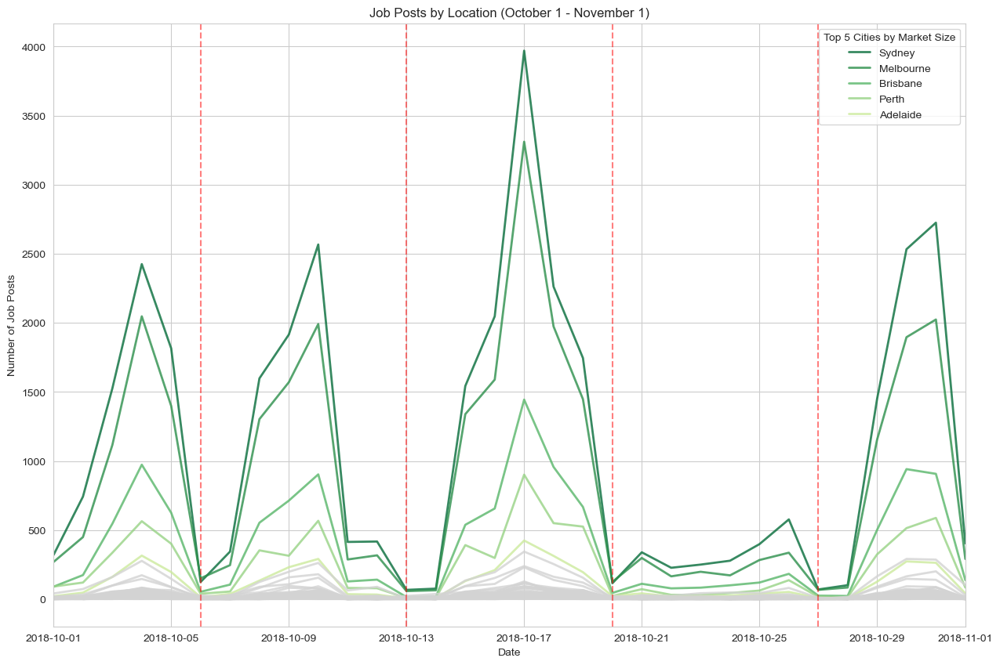

In [123]:
plt.figure(figsize=(15,10))
start_date = pd.to_datetime('2018-10-01')
end_date = pd.to_datetime('2018-11-01')

days_of_week = [5] # 5 represents Saturday (0=Mon, 1=Tue, ..., 7=Sun)


for location in top_locations.index[:5]:
    temp_loc_time_df = loc_time_df[df['Location'] == location].groupby('Date').count().reset_index().sort_values(by=['Date'])
    temp_loc_time_df = temp_loc_time_df.set_index('Date')
    location_over_time = temp_loc_time_df['Title'].rename('Count')
    plt.plot(location_over_time, alpha=0.8, lw=2)
vertical_lines_x = [timestamp for timestamp in temp_loc_time_df.index if timestamp.weekday() in days_of_week and ((timestamp <= end_date) and (timestamp >= start_date))]

for location in top_locations.index[5:]:
    temp_loc_time_df = loc_time_df[df['Location'] == location].groupby('Date').count().reset_index().sort_values(by=['Date'])
    temp_loc_time_df = temp_loc_time_df.set_index('Date')
    location_over_time = temp_loc_time_df['Title'].rename('Count')
    plt.plot(location_over_time, alpha=0.8, lw=2, c='lightgrey')
plt.legend(top_locations.index[:5], title='Top 5 Cities by Market Size', frameon=True)
plt.title('Job Posts by Location (October 1 - November 1)')
plt.xlabel('Date')
plt.ylabel('Number of Job Posts')

for x in vertical_lines_x:
    # Put red vertical lines on every Saturday
    plt.axvline(x=x, color='red', linestyle='--', alpha=0.5)  # Adjust color, linestyle, and transparency as needed

plt.xlim(start_date, end_date)
plt.show()


C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\1562150518.py:2: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



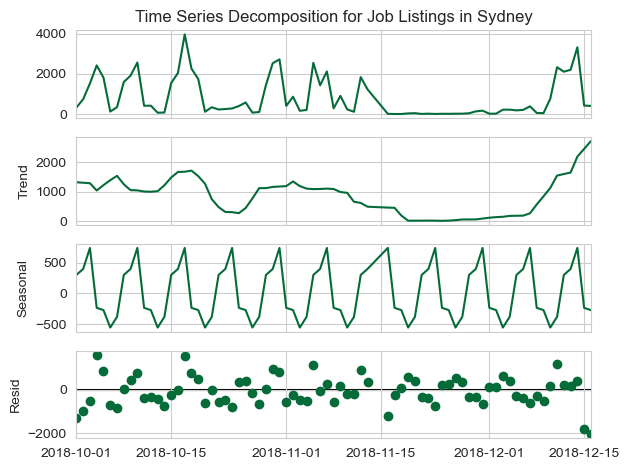

In [124]:
# decomposition
syd_df = loc_time_df[df['Location'] == 'Sydney'].groupby('Date').count().reset_index().sort_values(by=['Date'])
syd_df = syd_df.set_index('Date')
syd_series = syd_df['Title'].rename('Time Series Decomposition for Job Listings in Sydney')


# Plot the decomposition
syd_decomposition = seasonal_decompose(syd_series, period=7, extrapolate_trend='freq')
syd_decomposition.plot()


# Show the plot
plt.show()

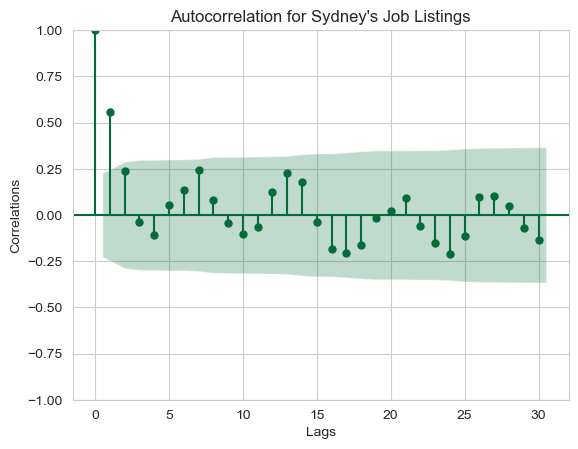

In [152]:
auto_corr_fig, ax = plt.subplots()
#figsize=(15,8)
auto_corr_fig = sm.graphics.tsa.plot_acf(syd_series, lags=30, title="Autocorrelation for Sydney's Job Listings", ax=ax)
ax.set_xlabel("Lags")
ax.set_ylabel("Correlations")
plt.show()

### **TREND ANALYSIS**

There is a very low number of job listings between roughly mid November 2018 to late November 2018, and there does not seem to be any relationship between the top sector of a city and its listing patterns. Each city selected seems to follow a relatively similar listing pattern.


The period of inactivity could be due to companies slowing down recruitment as the holiday season approaches where many employees are likely to take time off. The subsequent boom of listings just before the holiday period though is not explainable by this, except potentially being listings the company intends to investigate after the new year.

There appeared to be some seasonality during the week, which was explored by cropping the data range to October 1 to November 1 in the graph of job posts by location.  Saturdays in this month had the least number of job listings. The number of listings increases as the week progresses, peaking in the middle, then lowering again until Saturday.

Since Sydney had the largest market share and thus the most amount of data, it was used as the subject for further time series analysis.

The time series decomposition for job listings in Sydney plots the actual data, the trend, the seasonal, and the residiual noise for job listings in Sydney. The trend does not appear to show much information other than the lull and subsequent rise in listings between November 15th and December 15th.

The graph of autocorrelation for Sydney's job listings up to 30 lags shows peaks at lags=7, lags=14, and to a lesser degree lags=21. This supports the presence of weekly seasonality for Sydney's job listings.

This weekly seasonality could be due to the typical work week occuring from Monday to Friday. 


*Cosine Similarity*

In [27]:
syd_filtered_df = df[df['Location'] == "Sydney"]
syd_stripped = syd_filtered_df['Requirement'].dropna().apply(lambda x: clean_data(x))

adl_filtered_df = df[df['Location'] == 'Adelaide']
adl_stripped = adl_filtered_df['Requirement'].dropna().apply(lambda x: clean_data(x))

mackay_filtered_df = df[df['Location'] == 'Mackay & Coalfields']
mackay_stripped = mackay_filtered_df['Requirement'].dropna().apply(lambda x: clean_data(x))

act_filtered_df = df[df['Location'] == 'ACT']
act_stripped = act_filtered_df['Requirement'].dropna().apply(lambda x: clean_data(x))

gc_filtered_df = df[df['Location'] == 'Gold Coast']
gc_stripped = gc_filtered_df['Requirement'].dropna().apply(lambda x: clean_data(x))


syd_txt = ' '.join(syd_stripped.fillna('')).lower()
syd_words = set(syd_txt.split())

adl_txt = ' '.join(adl_stripped.fillna('')).lower()
adl_words = set(adl_txt.split())

act_txt = ' '.join(act_stripped.fillna('')).lower()
act_words = set(act_txt.split())

gc_txt = ' '.join(gc_stripped.fillna('')).lower()

mackay_txt = ' '.join(mackay_stripped.fillna('')).lower()

intersection_syd_adl = syd_words.intersection(adl_words)
union_syd_adl = syd_words.union(adl_words)

intersection_adl_act = adl_words.intersection(act_words)
union_adl_act = adl_words.union(act_words)

intersection_syd_act = syd_words.intersection(act_words)
union_syd_act = syd_words.union(act_words)

C:\Users\Madi\AppData\Local\Temp\ipykernel_3180\3736684148.py:6: MarkupResemblesLocatorWarning:

The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.

C:\Users\Madi\AppData\Local\Temp\ipykernel_3180\3736684148.py:6: MarkupResemblesLocatorWarning:

The input looks more like a URL than markup. You may want to use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.



In [30]:
import plotly.express as px
from sklearn.metrics.pairwise import cosine_similarity
custom_stop_words = stop_words + "join work currently time experienced team seeking career business client large initial department month experience health markey location role needed required permanent exciting within company one product start brisbane background great australia high 12 new 2019 clients immediate contract opportunity looking".split(" ")
vectorizer = TfidfVectorizer(stop_words=custom_stop_words)
tf_idf = vectorizer.fit_transform([syd_txt, adl_txt, act_txt, gc_txt, mackay_txt]).toarray()
similarity = cosine_similarity(tf_idf, tf_idf)

city_labels = ['Syd', 'Adl', 'ACT', 'GC', 'Mackay']
sim_df = pd.DataFrame(similarity, columns=city_labels, index=city_labels)
cosine_sim_heatmap = px.imshow(sim_df, 

                                x=city_labels, 
                                y=city_labels, 
                                color_continuous_scale='YlGn', 
                                text_auto=True)

cosine_sim_heatmap.update_layout(title='Interactive Heatmap of Cosine Similarity between Top Cities witih Differing Biggest Sectors', xaxis_title='Cities', yaxis_title='Cities')

cosine_sim_heatmap.show()

**ANALYSIS**


The cosine similarity heatmap compares Sydney, Adelaide, ACT, Gold Coast, and Mackay & Coalfields job requirements sections. Sydney and Adelaide were the most similar, while the ACT and Mackay & Coalfields were the most different. The heatmap shows that different locations may be seeking different requirements.

*Doing TfIDF*

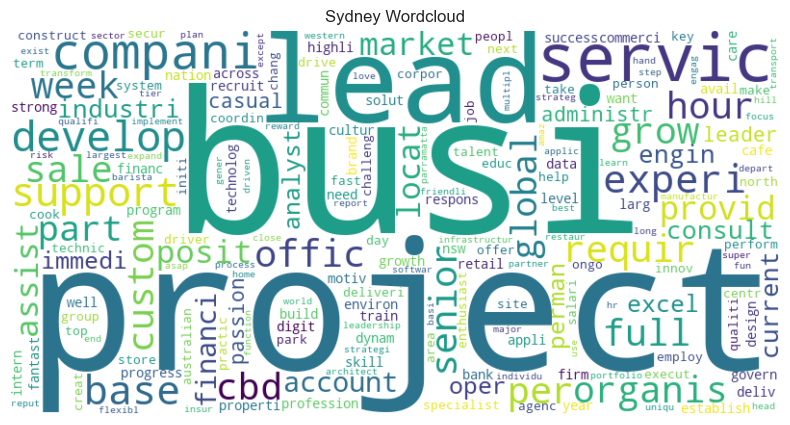

In [38]:
custom_stop_words = stop_words + "join work manag seek look sydney adelaid mackay excit opportun experienc currently time experienced team seeking career business client large initial department month experience health markey location role needed required permanent exciting within company one product start brisbane background great australia high 12 new 2019 clients immediate contract opportunity looking".split(" ")


vectorizer = TfidfVectorizer(stop_words=custom_stop_words)
syd_tfidf_mat = vectorizer.fit_transform(syd_stripped)
syd_feature_names = vectorizer.get_feature_names_out()
sum_of_rows = syd_tfidf_mat.sum(axis=0)

dict_ = {}
for word, idx in vectorizer.vocabulary_.items():
    dict_[word] = sum_of_rows[0, idx]

syd_wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(dict_)
plt.figure(figsize=(10,5))
plt.imshow(syd_wordcloud, interpolation='bilinear')
plt.title('Sydney Wordcloud')
plt.axis('off')
plt.show()

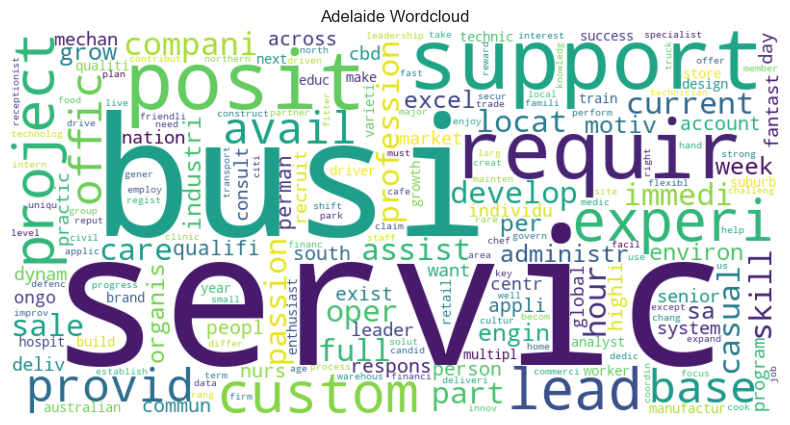

In [39]:

vectorizer = TfidfVectorizer(stop_words=custom_stop_words)
adl_tfidf_mat = vectorizer.fit_transform(adl_stripped)
adl_feature_names = vectorizer.get_feature_names_out()
sum_of_rows = adl_tfidf_mat.sum(axis=0)

dict_ = {}
for word, idx in vectorizer.vocabulary_.items():
    dict_[word] = sum_of_rows[0, idx]

adl_wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(dict_)
plt.figure(figsize=(10,5))
plt.imshow(adl_wordcloud, interpolation='bilinear')
plt.title('Adelaide Wordcloud')
plt.axis('off')
plt.show()

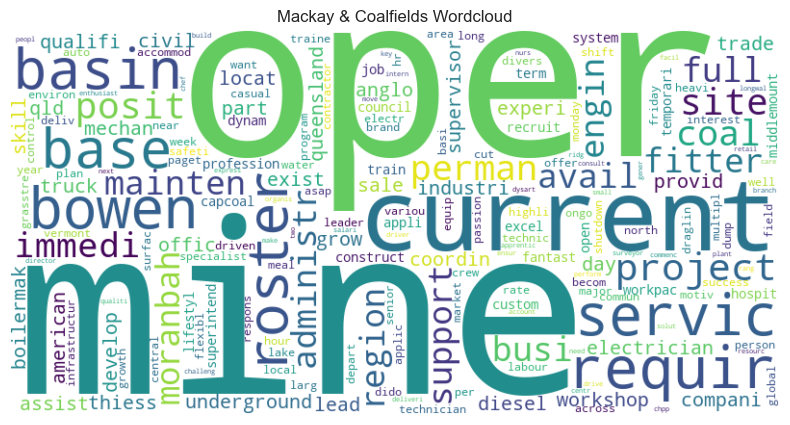

In [40]:

vectorizer = TfidfVectorizer(stop_words=custom_stop_words)
mcky_tfidf_mat = vectorizer.fit_transform(mackay_stripped)
mcky_feature_names = vectorizer.get_feature_names_out()
sum_of_rows = mcky_tfidf_mat.sum(axis=0)

dict_ = {}
for word, idx in vectorizer.vocabulary_.items():
    dict_[word] = sum_of_rows[0, idx]

mcky_wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(dict_)
plt.figure(figsize=(10,5))
plt.imshow(mcky_wordcloud, interpolation='bilinear')
plt.title('Mackay & Coalfields Wordcloud')
plt.axis('off')
plt.show()

**ANALYSIS**

The most popular terms have similarities between Sydney and Adelaide, despite the two having fairly different job markets. This is in line with their high cosine similarity. Sydney did seem to have a higher emphasis on leadership, whereas support was much more popular terms in Adelaide's requirements. Mackay & Coalfields differed significantly from Sydney and Adelaide's wordclouds, having an expectedly greater emphasis on technical terms. These wordmaps show that an employee may have an easier time moving from Adelaide to Sydney than from Sydney to Mackay or visa versa.

___
# 3) Study by sectors
___
Analysing the data by sectors will provide answers regarding skils and sectors favoured in the market

_Getting number of postings for each sector_

In [46]:
sectorDf = df[df['Classification'].isna()==False]
sectorDf = sectorDf.groupby('Classification').count()
sectorDf['Classification'] = sectorDf.index
sectorDf['Count'] = sectorDf["Id"]
sectorDf = sectorDf.sort_values(by='Count', ascending=False)
sectorDf.head(5)

,Unnamed: 0,Id,Title,Company,Date,Location,Area,SubClassification,Requirement,FullDescription,LowestSalary,HighestSalary,JobType,AverageSalary,Classification,Count
Classification,,,,,,,,,,,,,,,,
Information & Communication Technology,22796,22796,22796,22447,22796,22796,16090,22796,22796,21162,22796,22796,21163,22796,Information & Communication Technology,22796
Trades & Services,17976,17976,17976,16500,17976,17976,9671,17976,17976,17125,17976,17976,17126,17976,Trades & Services,17976
Healthcare & Medical,17085,17085,17085,16390,17085,17085,7961,17085,17085,16380,17085,17085,16383,17085,Healthcare & Medical,17085
Hospitality & Tourism,15523,15523,15523,14890,15523,15523,9642,15523,15523,14294,15523,15523,14298,15523,Hospitality & Tourism,15523
"Manufacturing, Transport & Logistics",12376,12376,12376,11465,12376,12376,8545,12376,12376,11752,12376,12376,11754,12376,"Manufacturing, Transport & Logistics",12376


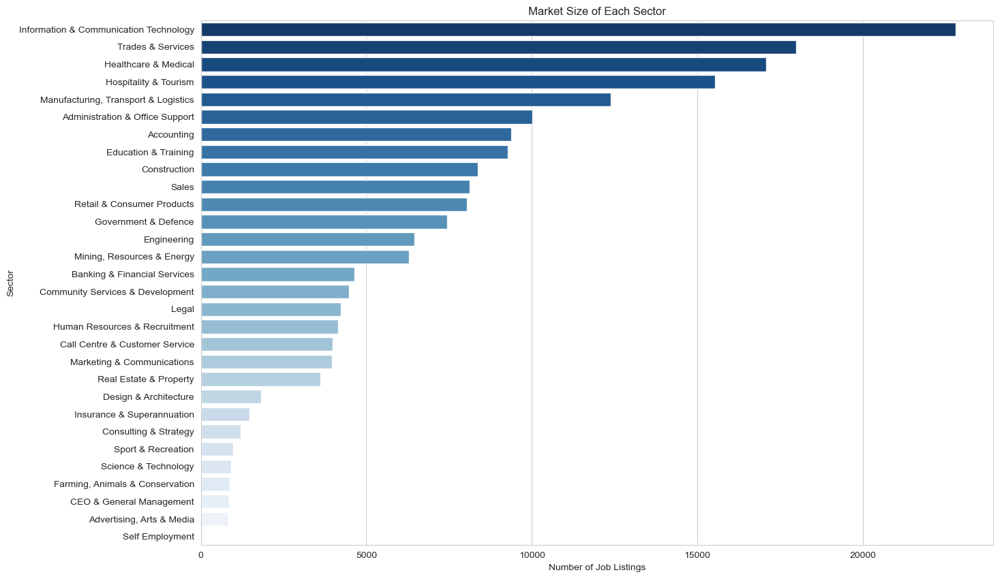

In [47]:
plt.figure(figsize=(15,10)) 
sns.barplot(
    data=sectorDf, 
    x='Count', 
    y='Classification', 
    palette="Blues_r"
)
#plt.grid()
plt.xlabel("Number of Job Listings")
plt.ylabel("Sector")
plt.title("Market Size of Each Sector")
plt.show()

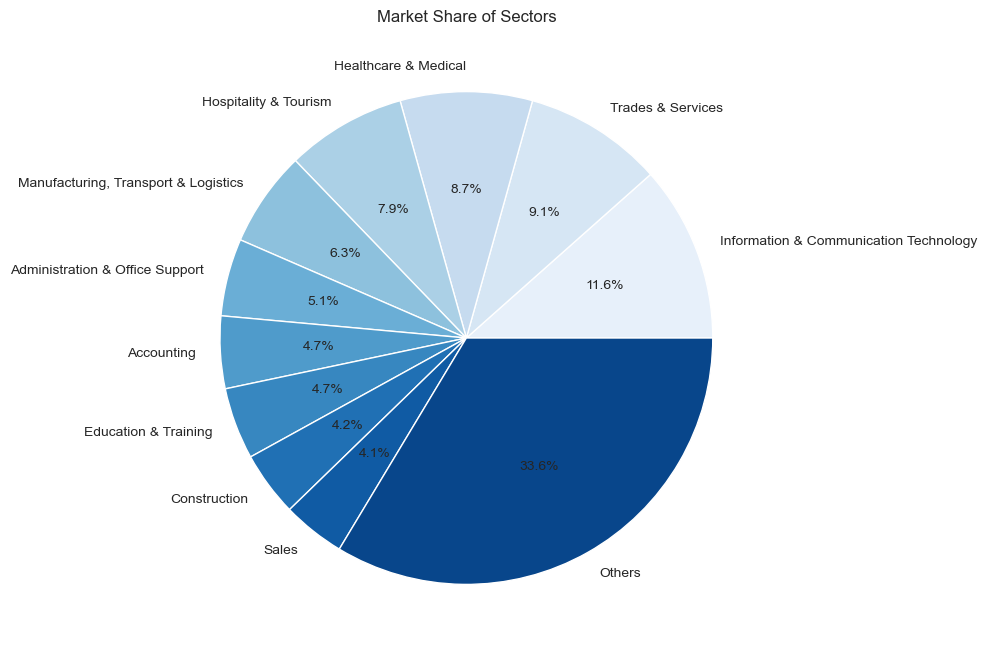

In [48]:
# Pie chart for job market share of classifications
df2 = sectorDf[:10].copy()
new_row = pd.DataFrame(data = {
    'Classification' : ['Others'],
    'Count' : [sectorDf["Count"][10:].sum()]
})

df2 = pd.concat([df2, new_row])
df2.index = df2['Classification']

sns.set_palette('Blues',n_colors=11)
plt.figure(figsize=(8,8))
plt.title("Market Share of Sectors")
plt.pie(
    df2['Count'],
    labels=df2['Classification'],
    autopct='%1.1f%%'
)
plt.show()

_Visualizing the salary range in the sectors/sub-sectors_

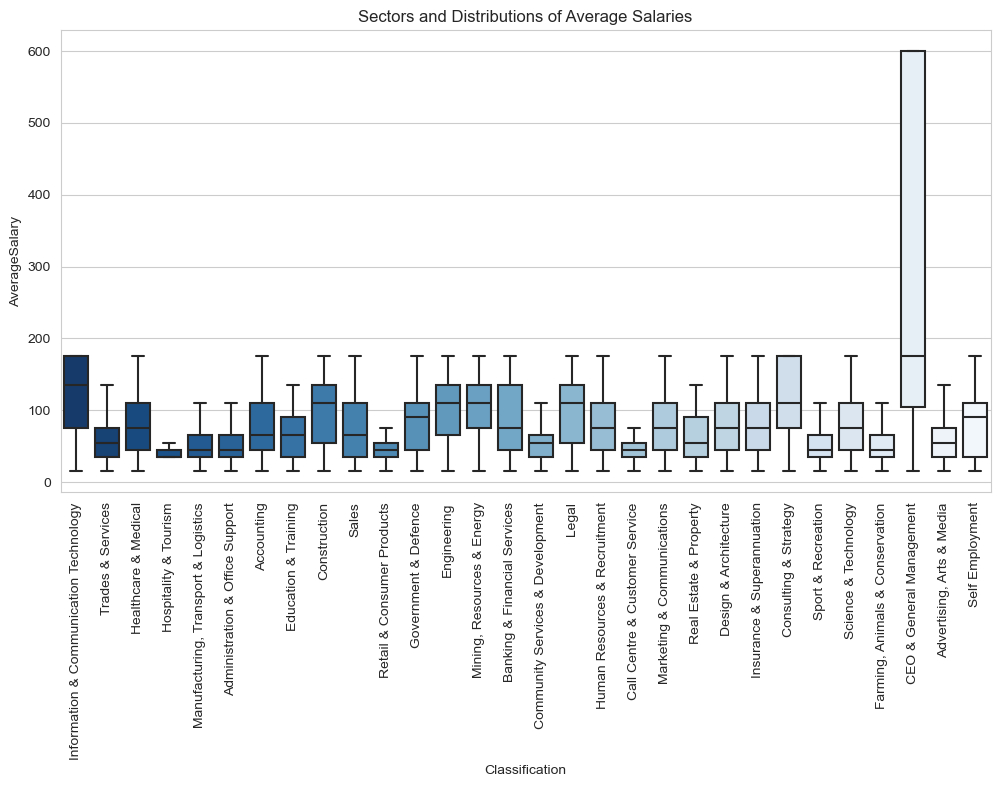

In [49]:
#your code here
plt.figure(figsize=(12,6))
sns.boxplot(
    data=df,
    x='Classification',
    y='AverageSalary',
    palette=sns.color_palette('Blues_r',n_colors=30),
    order=sectorDf["Classification"],
    showfliers=False # OUTLIERS ARE EXCLUDED.
)
plt.xticks(rotation=90)
plt.title("Sectors and Distributions of Average Salaries")
plt.show()

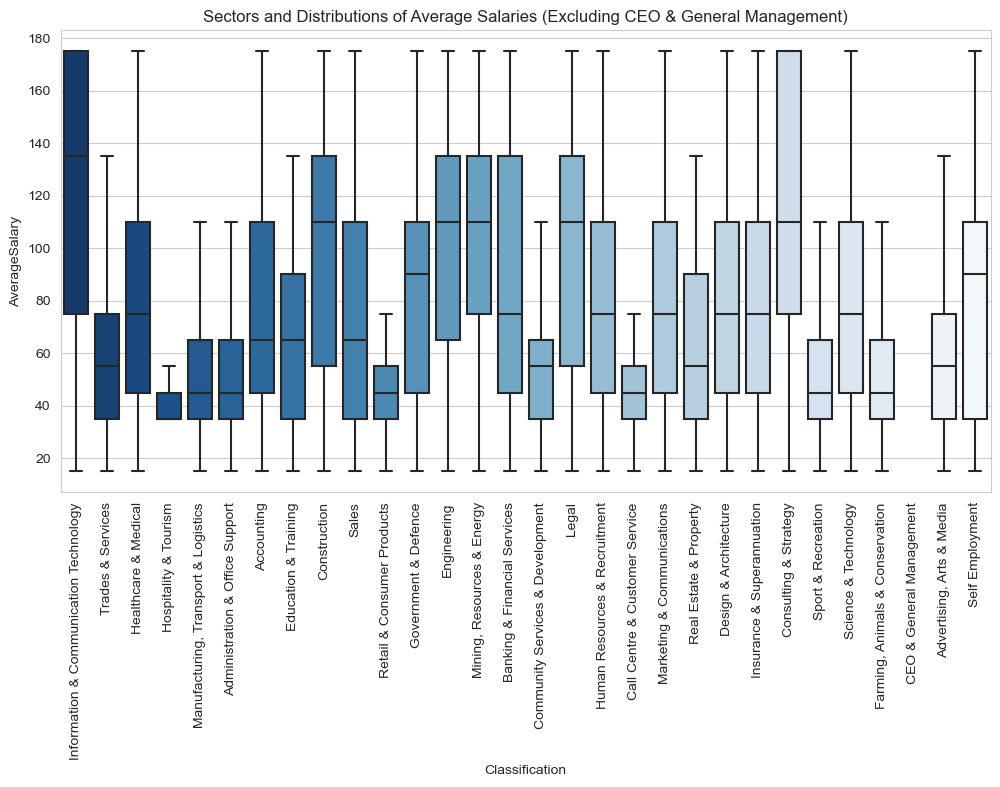

In [50]:
#your code here
plt.figure(figsize=(12,6))
sns.boxplot(
    data=df[df['Classification'] != 'CEO & General Management'],
    x='Classification',
    y='AverageSalary',
    palette=sns.color_palette('Blues_r',n_colors=30),
    order=sectorDf["Classification"],
    showfliers=False # OUTLIERS ARE EXCLUDED.
)
plt.xticks(rotation=90)
plt.title("Sectors and Distributions of Average Salaries (Excluding CEO & General Management)")
plt.show()

### **ANALYSIS**

There are 30 sectors with the most popular being IT, followed by Trades & Services, Medical, Hospitality & Tourism and in fifth place was Manufacturing, Transport & Logistics. This aligns with the observations made in the initial unpacking of job metadata that a large portion of listings were from IT and Trade recruitment agencies.

From the boxplot, it is clear that CEO & General Management has very high average salries. Hospitality & Tourism and Retail & Consumer Products had the lowest. IT Showed relatively high average salaries especially when compared to the next most popular job sector, Trades & Services. Interestingly for IT, the median was much closer to the highest salary datapoint (excluding outliers) than the lowest salary datapoint. This shows that half of all listings for IT were around 300k+ Trades & Services on the other hand had more listings with an average salary closer to their lowest datapoint, with the highest average salary (exclusing outliers) for trade & services being roughly equal to the median for IT. Healthcare showed a much higher median than Trades & Services, but the median of average salaries for health were still skewed to the low end.

___
## Studying by Sub-Sector
___

 _Market Share of SubSectors for Top 4 Sectors_

In [43]:
tradesDf = df[df['Classification'] == 'Trades & Services']
tradesCounts = tradesDf['SubClassification'].value_counts()
tradesCounts = tradesCounts.sort_values(ascending=False)

itDf = df[df['Classification'] == 'Information & Communication Technology']
itCounts = itDf['SubClassification'].value_counts()
itCounts = itCounts.sort_values(ascending=False)

healthDf = df[df['Classification'] == 'Healthcare & Medical']
healthCounts = healthDf['SubClassification'].value_counts()
healthCounts = healthCounts.sort_values(ascending=False)

hospoDf = df[df['Classification'] == 'Hospitality & Tourism']
hospoCounts = hospoDf['SubClassification'].value_counts()
hospoCounts = hospoCounts.sort_values(ascending=False)

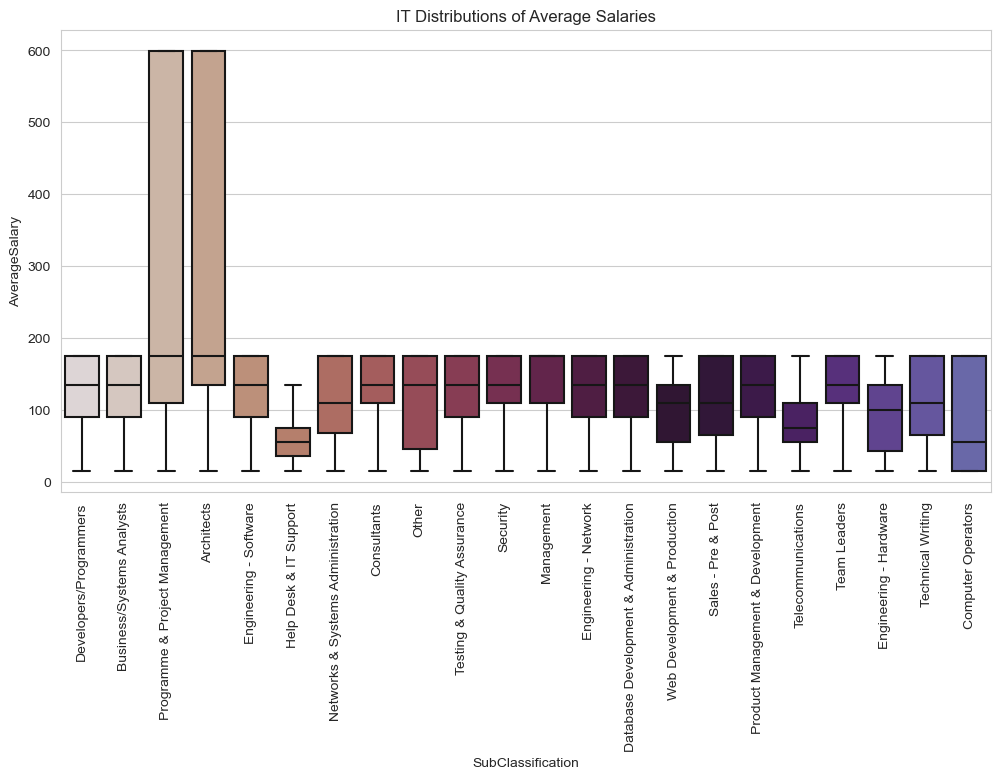

In [52]:
plt.figure(figsize=(12, 6))
sns.boxplot(
    data=itDf,
    x='SubClassification',
    y='AverageSalary',
    palette=sns.color_palette('twilight_r',n_colors=30),
    order=itCounts.index,
    showfliers=False # OUTLIERS ARE EXCLUDED.
)
plt.xticks(rotation=90)
plt.title("IT Distributions of Average Salaries")
plt.show()

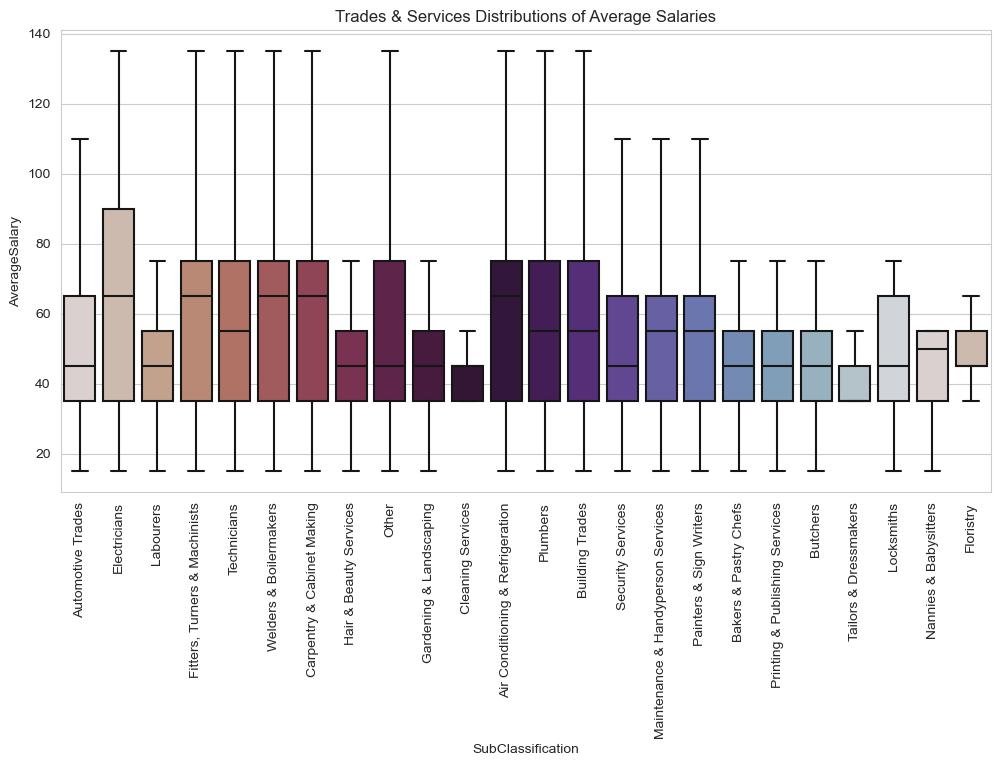

In [53]:
plt.figure(figsize=(12, 6))
sns.boxplot(
    data=tradesDf,
    x='SubClassification',
    y='AverageSalary',
    palette=sns.color_palette('twilight_r',n_colors=22),
    order=tradesCounts.index,
    showfliers=False # OUTLIERS ARE EXCLUDED.
)
plt.xticks(rotation=90)
plt.title("Trades & Services Distributions of Average Salaries")
plt.show()

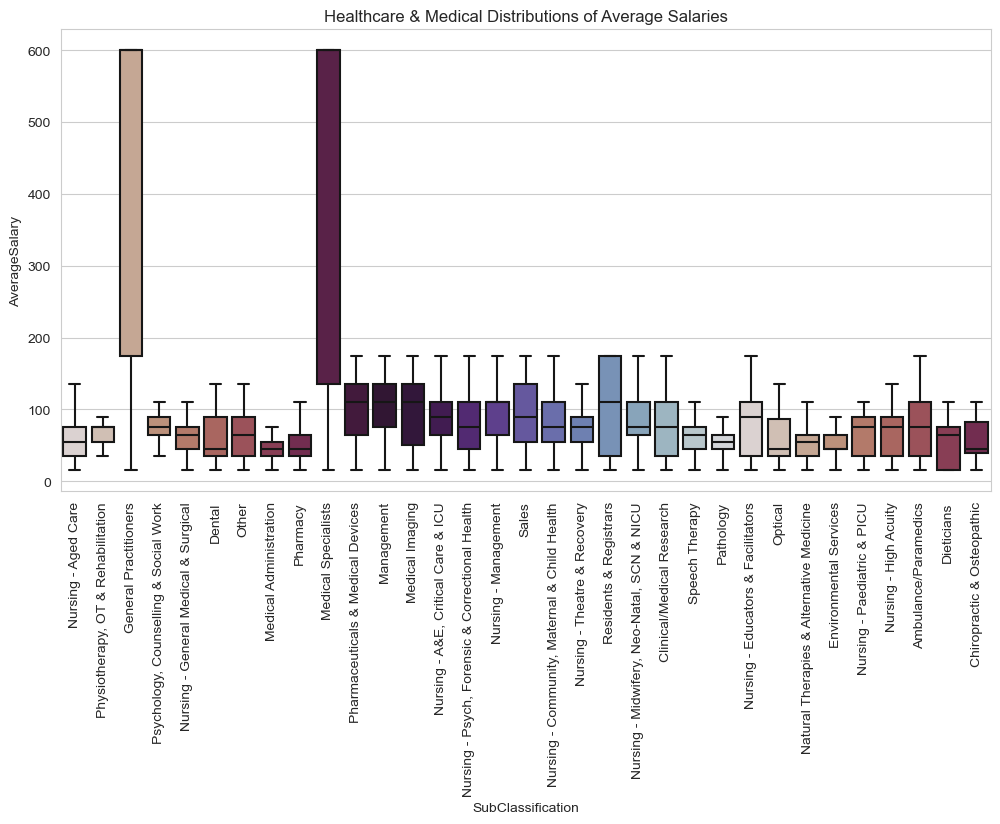

In [54]:
plt.figure(figsize=(12, 6))
sns.boxplot(
    data=healthDf,
    x='SubClassification',
    y='AverageSalary',
    palette=sns.color_palette('twilight_r',n_colors=24),
    order=healthCounts.index,
    showfliers=False # OUTLIERS ARE EXCLUDED.
)
plt.xticks(rotation=90)
plt.title("Healthcare & Medical Distributions of Average Salaries")
plt.show()

In [55]:
it_pie = itDf.groupby('SubClassification').count()
it_pie["SubClassification"] = it_pie.index
it_pie["Count"] = it_pie["Id"]
it_pie = it_pie.sort_values(by='Count', ascending=False)

it_df2 = it_pie[:10].copy()
it_new_row = pd.DataFrame(data = {
    'SubClassification' : ['Others'],
    'Count' : [it_pie["Count"][10:].sum()]
})

it_df2 = pd.concat([it_df2, it_new_row], sort=False)
it_df2.index = it_df2["SubClassification"]
it_df2

,Unnamed: 0,Id,Title,Company,Date,Location,Area,Classification,Requirement,FullDescription,LowestSalary,HighestSalary,JobType,AverageSalary,SubClassification,Count
SubClassification,,,,,,,,,,,,,,,,
Developers/Programmers,4211.0,4211.0,4211.0,4090.0,4211.0,4211.0,3147.0,4211.0,4211.0,3955.0,4211.0,4211.0,3955.0,4211.0,Developers/Programmers,4211
Business/Systems Analysts,2986.0,2986.0,2986.0,2954.0,2986.0,2986.0,2097.0,2986.0,2986.0,2713.0,2986.0,2986.0,2713.0,2986.0,Business/Systems Analysts,2986
Programme & Project Management,2413.0,2413.0,2413.0,2381.0,2413.0,2413.0,1651.0,2413.0,2413.0,2182.0,2413.0,2413.0,2182.0,2413.0,Programme & Project Management,2413
Architects,1548.0,1548.0,1548.0,1540.0,1548.0,1548.0,1053.0,1548.0,1548.0,1442.0,1548.0,1548.0,1442.0,1548.0,Architects,1548
Engineering - Software,1437.0,1437.0,1437.0,1417.0,1437.0,1437.0,1102.0,1437.0,1437.0,1370.0,1437.0,1437.0,1370.0,1437.0,Engineering - Software,1437
Help Desk & IT Support,1374.0,1374.0,1374.0,1332.0,1374.0,1374.0,1033.0,1374.0,1374.0,1293.0,1374.0,1374.0,1294.0,1374.0,Help Desk & IT Support,1374
Networks & Systems Administration,1194.0,1194.0,1194.0,1182.0,1194.0,1194.0,810.0,1194.0,1194.0,1124.0,1194.0,1194.0,1124.0,1194.0,Networks & Systems Administration,1194
Consultants,1149.0,1149.0,1149.0,1133.0,1149.0,1149.0,790.0,1149.0,1149.0,1094.0,1149.0,1149.0,1094.0,1149.0,Consultants,1149
Other,997.0,997.0,997.0,991.0,997.0,997.0,569.0,997.0,997.0,916.0,997.0,997.0,916.0,997.0,Other,997


In [56]:
it_pie = itDf.groupby('SubClassification').count()
it_pie["SubClassification"] = it_pie.index
it_pie["Count"] = it_pie["Id"]
it_pie = it_pie.sort_values(by='Count', ascending=False)

it_df2 = it_pie[:10].copy()
it_new_row = pd.DataFrame(data = {
    'SubClassification' : ['Others'],
    'Count' : [it_pie["Count"][10:].sum()]
})

it_df2 = pd.concat([it_df2, it_new_row], sort=False)
it_df2.index = it_df2["SubClassification"]


trd_pie = tradesDf.groupby('SubClassification').count()
trd_pie["SubClassification"] = trd_pie.index
trd_pie["Count"] = trd_pie["Id"]
trd_pie = trd_pie.sort_values(by='Count', ascending=False)

trd_df2 = trd_pie[:10].copy()
trd_new_row = pd.DataFrame(data = {
    'SubClassification' : ['Others'],
    'Count' : [trd_pie["Count"][10:].sum()]
})

trd_df2 = pd.concat([trd_df2, trd_new_row], sort=False)
trd_df2.index = trd_df2["SubClassification"]


health_pie = healthDf.groupby('SubClassification').count()
health_pie["SubClassification"] = health_pie.index
health_pie["Count"] = health_pie["Id"]
health_pie = health_pie.sort_values(by='Count', ascending=False)

health_df2 = health_pie[:10].copy()
health_new_row = pd.DataFrame(data = {
    'SubClassification' : ['Others'],
    'Count' : [health_pie["Count"][10:].sum()]
})

health_df2 = pd.concat([health_df2, health_new_row], sort=False)
health_df2.index = health_df2["SubClassification"]

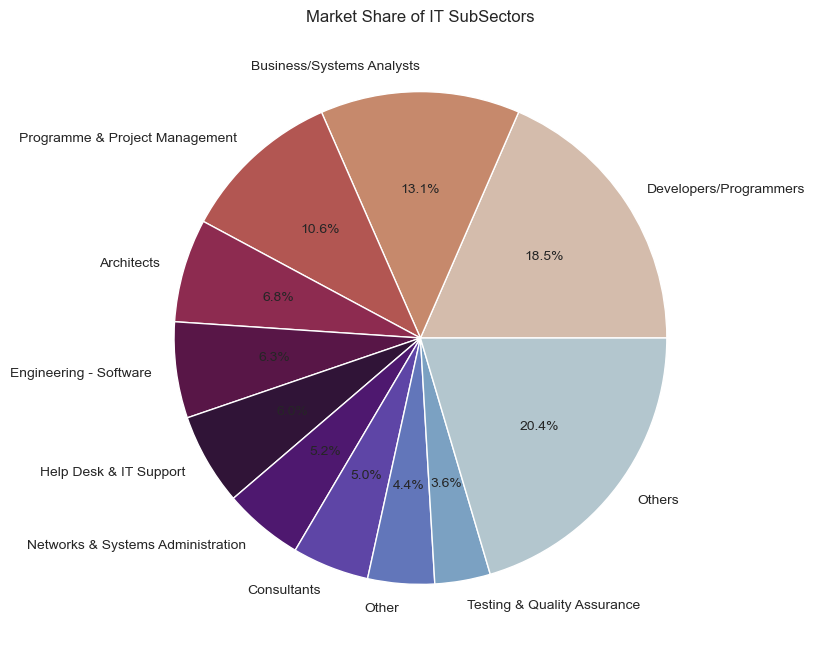

In [57]:
sns.set_palette('twilight_r',n_colors=11)
plt.figure(figsize=(8,8))
plt.title("Market Share of IT SubSectors")
plt.pie(it_df2['Count'],labels=it_df2['SubClassification'],autopct='%1.1f%%')
plt.show()

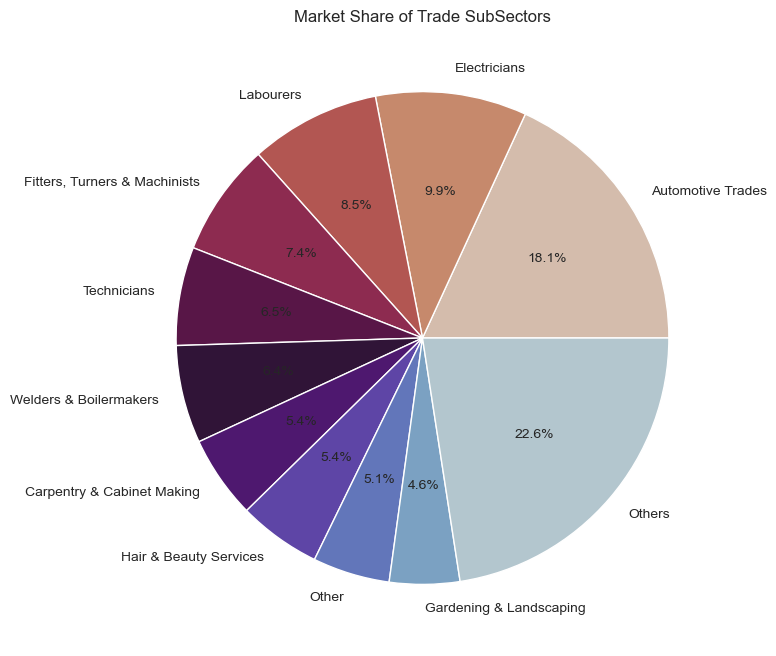

In [58]:
sns.set_palette('twilight_r',n_colors=11) 
plt.figure(figsize=(8,8))
plt.title("Market Share of Trade SubSectors")
plt.pie(trd_df2['Count'],labels=trd_df2['SubClassification'],autopct='%1.1f%%')
plt.show()

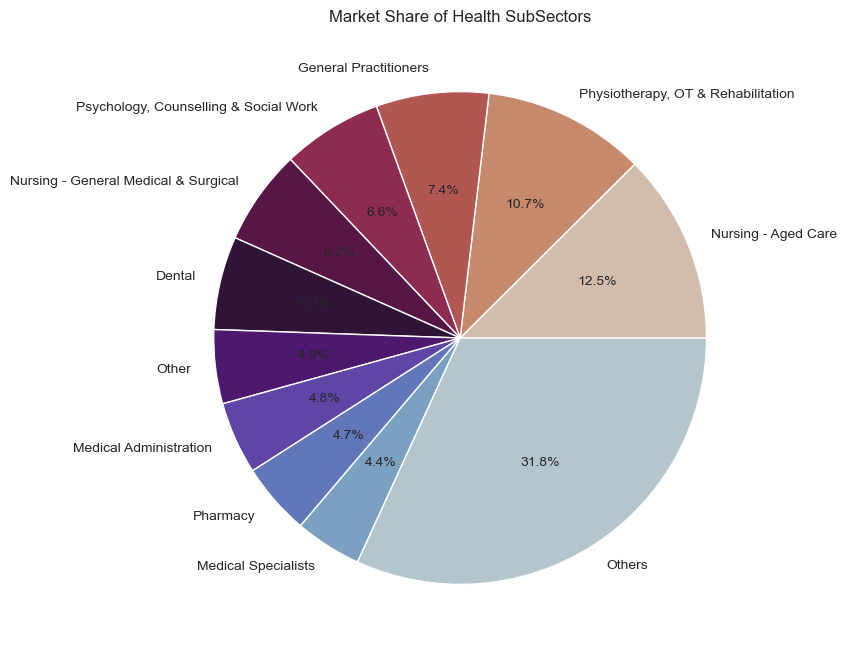

In [59]:
sns.set_palette('twilight_r',n_colors=11) 
plt.figure(figsize=(8,8))
plt.title("Market Share of Health SubSectors")
plt.pie(health_df2['Count'],labels=health_df2['SubClassification'],autopct='%1.1f%%')
plt.show()

In [61]:
time_sect_df = df.copy()
time_sect_df['Date'] - pd.to_datetime(time_sect_df['Date'])
time_sect_df['Count'] = 1
time_sect_df = time_sect_df.sort_values(by='Date')
time_sect_df['CumuCount'] = time_sect_df.groupby('Classification')['Count'].cumsum()

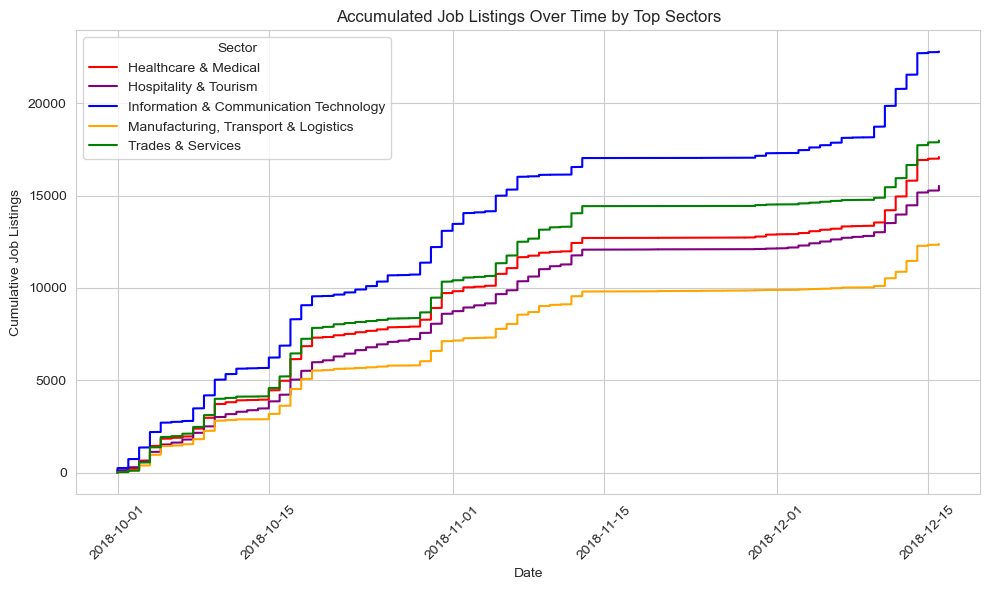

In [62]:
# Calculate total number of listings for each sector
sector_counts = time_sect_df['Classification'].value_counts()

# Identify top 5 sectors
top_5_sectors = sector_counts.head(5).index
bottom_5_sectors = sector_counts[-5:].index

sector_ranks = {sector: rank for rank, sector in enumerate(top_5_sectors, start=1)}
colors = ['blue', 'green', 'red', 'purple', 'orange']



plt.figure(figsize=(10, 6))

for classification, group in time_sect_df.groupby('Classification'):
    if classification in top_5_sectors:
        # Plot top 5 sectors with specific color and label
        rank = sector_ranks[classification]
        color = colors[rank - 1]
        plt.plot(group['Date'], group['CumuCount'], label=classification, color=color)

plt.xlabel('Date')
plt.ylabel('Cumulative Job Listings')
plt.title('Accumulated Job Listings Over Time by Top Sectors')
plt.legend(title='Sector')
plt.xticks(rotation=45)
plt.tight_layout()

plt.show()

### **ANALYSIS**

The sub-sectors of the top 3 sectors (IT, Trades & Services, and Health & Medical) were investigated with boxplots and pie charts. The boxplots display the average salary distribution for each subsector and the pie charts show the market share of the top sectors. IT had 22 subsectors, Trades & Services had 24, and Health & Medical had 33. The most in demand sub-sectors for each sector were: Developers/Programmers, Automotive Trades, and Nursing - Aged Care. IT median average salaries skewed closer to the highest average salary for each subsector relative to Trades & Services and Health & Medical. Health & Medical showed the most variance in salaries and the most variety in jobs per sub-sector, which aligns with there being many different medical specializations. IT had the most concentration of jobs in one sub-sector, with 19% of all listings being for Developers/Programmers, which could be explained by the broadness of that field. The second most popular listing type for Trades & Services was for Electritians, which were relatively high paid for the trade sub-sectors. For IT, Programme & Project Management and Architects showed the highest earning potential by far, but they were the 3rd and 4th most popular sub-sectors and accounted for 10.9% and 13.5% of all listings respectively. The 1st and 2nd most popular sub-sectors for Healthcare & Medical, Nursing - Aged Care and Physiotherapy, OT & Rehabilitation, showed moderate average salaries relative to the other sub-sectors, but the third most popular sub-sector was General Practitioners accounting for 8% of all listings and had one of the highest by far average salaries for the sector. Each top 5 sector had a similar growth rate, and this plot visualises how IT has the most listings by a relatively large margin. The trend for Hospitality & Tourism closely followed that for Healthcare & Medical. No sectors had negative growth because listings were never removed or given an expiry date in this dataset.


Since IT has the most job listings and consistently high wages relative to other sectors for each sub-sector, it will be further investigated to extrapolate more information, particularly related to its skills and its sub-sectors.

### _Extracting Skills Information from IT Sector_


#### _Attempt 1: IT Wordcloud_

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\3736684148.py:6: MarkupResemblesLocatorWarning:

The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.



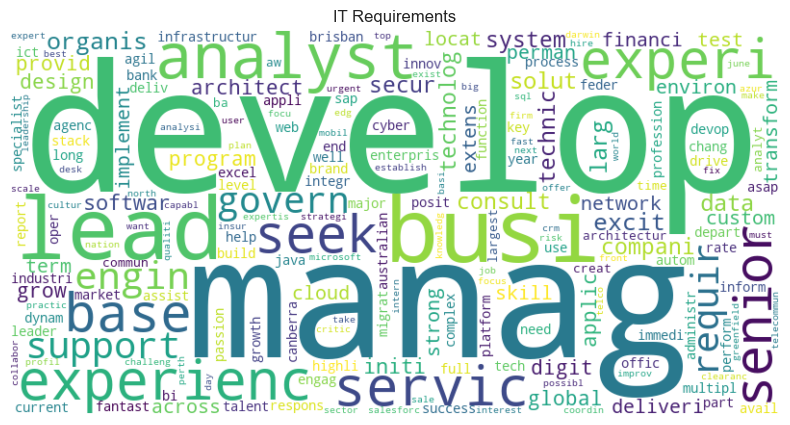

In [63]:
it_filtered_df = df[df['Classification'] == "Information & Communication Technology"]
it_stripped = it_filtered_df['Requirement'].dropna().apply(lambda x: clean_data(x))
custom_stop_words = stop_words + "melbourn look join team nz oz byron project opportun experienced work mackay cbd seeking career business client large initial department month experience health markey location role needed required permanent exciting within company one product start brisbane melbourne sydney adelaide background great australia high nsw 12 new 2019 clients immediate contract opportunity looking".split(" ")

vectorizer = TfidfVectorizer(stop_words=custom_stop_words)
it_tfidf_mat = vectorizer.fit_transform(it_stripped)
it_feature_names = vectorizer.get_feature_names_out()
sum_of_rows = it_tfidf_mat.sum(axis=0)

it_req_dict = {}
for word, idx in vectorizer.vocabulary_.items():
    it_req_dict[word] = sum_of_rows[0, idx]

it_wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(it_req_dict)
plt.figure(figsize=(10,5))
plt.title("IT Requirements")
plt.imshow(it_wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

#### _Attempt 2: Clustering IT Job Titles_

In [64]:
from sklearn.cluster import KMeans
# Should be:There are 12463 unique job titles for IT before cleaning
print('There are {} unique job titles for IT before cleaning'.format(itDf['Title'].nunique()))

it_filtered_df['cleaned Title'] = itDf['Title'].dropna().apply(lambda x: clean_data(x))

print('There are {} unique job titles for IT after cleaning'.format(it_filtered_df['cleaned Title'].nunique()))

There are 12463 unique job titles for IT before cleaning


C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\3736684148.py:6: MarkupResemblesLocatorWarning:

The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.



There are 10718 unique job titles for IT after cleaning


C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\1932491322.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [65]:
it_cust_sw = custom_stop_words + 'technical technic software'.split(' ')


# Vectorize job titles
vectorizer = TfidfVectorizer(ngram_range=(1,3), stop_words = it_cust_sw) # extract bigrams to get phrases instead of single words
X = vectorizer.fit_transform(it_filtered_df['cleaned Title'])

# Apply KMeans clustering
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
it_filtered_df['Cluster'] = kmeans.fit_predict(X)


# Check the top terms in each cluster
order_centroids = kmeans.cluster_centers_.argsort()[:, ::-1]
terms = vectorizer.get_feature_names_out()


for i in range(num_clusters):
    print(f"Cluster {i}:")
    for ind in order_centroids[i, :10]:  # Top 10 terms per cluster
        print(f' {terms[ind]}')
    print("\n")
    
# Check some titles in each cluster
for i in range(num_clusters):
    print(f"Cluster {i} titles:")
    print(it_filtered_df[it_filtered_df['Cluster'] == i]['Title'].head(10))
    print("\n")


c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\joblib\externals\loky\backend\context.py:110: UserWarning:

Could not find the number of physical cores for the following reason:
found 0 physical cores < 1
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.

  File "c:\Users\jmere\miniconda3\envs\jacco-env-miniconda\Lib\site-packages\joblib\externals\loky\backend\context.py", line 217, in _count_physical_cores
    raise ValueError(


Cluster 0:
 develop
 java develop
 java
 senior
 senior develop
 softwar develop
 stack
 full
 full stack
 stack develop


Cluster 1:
 manag
 senior manag
 senior
 chang manag
 program manag
 chang
 program
 manag manag
 senior manag manag
 manag senior manag


Cluster 2:
 engin
 softwar engin
 network
 network engin
 system engin
 softwar
 devop engin
 devop
 system
 senior


Cluster 3:
 busi analyst
 busi
 analyst
 senior busi analyst
 senior busi
 senior
 digit busi analyst
 digit busi
 digit
 busi analyst busi


Cluster 4:
 analyst
 manag
 architect
 solut
 senior
 consult
 lead
 support
 data
 busi


Cluster 0 titles:
96        Business Development Manager
249             Cache/VB.Net Developer
316     Front End Javascript Developer
576         Junior Front End Developer
610            Front End Web Developer
648                 .NET Web Developer
1102                    RUBY Developer
1224              JavaScript Developer
1265                     iOS Developer
1311              

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\4046459986.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



#### _Attempt 3: Using Skill Terms Generated by ChatGPT_

In [41]:
it_skill_terms = list(set([
    # Programming Languages
    'Python', 'Java', 'JavaScript', 'C#', 'C++', 'Ruby', 'Swift', 'Kotlin',
    'Go', 'Rust', 'Scala', 'Clojure', 'Haskell', 'Objective-C', 'PHP',
    'TypeScript', 'Perl', 'R', 'Lua', 'Dart', 'Assembly', 'Bash', 'Shell Scripting',
    
    # Web Development
    'HTML', 'CSS', 'JavaScript', 'Node.js', 'React', 'Angular', 'Vue.js',
    'jQuery', 'Bootstrap', 'SASS', 'Less', 'Django', 'Flask', 'Express.js',
    'ASP.NET', 'Ruby on Rails', 'Symfony', 'Laravel', 'CodeIgniter', 'WordPress',
    'Magento', 'Drupal', 'Shopify', 'WooCommerce', 'BigCommerce', 'Joomla',
    
    # Mobile Development
    'Android', 'iOS', 'Swift', 'Objective-C', 'React Native', 'Flutter',
    'Xamarin', 'Kotlin', 'Java', 'SwiftUI', 'Mobile UI/UX Design',
    
    # Backend Development
    'RESTful API', 'GraphQL', 'Microservices', 'Serverless', 'Containerization',
    'Docker', 'Kubernetes', 'AWS Lambda', 'Google Cloud Functions', 'Azure Functions',
    'Firebase', 'Heroku', 'CI/CD', 'Message Queues', 'RabbitMQ', 'Kafka',
    
    # Frontend Development
    'Responsive Design', 'Cross-Browser Compatibility', 'Web Accessibility',
    'Performance Optimization', 'Progressive Web Apps (PWA)', 'Single Page Applications (SPA)',
    'Websockets', 'WebRTC', 'Service Workers', 'Browser DevTools',
    
    # Database
    'SQL', 'NoSQL', 'MySQL', 'PostgreSQL', 'MongoDB', 'Redis', 'Elasticsearch',
    'Firebase Firestore', 'DynamoDB', 'SQLite', 'Oracle', 'Microsoft SQL Server',
    
    # DevOps & Infrastructure
    'Git', 'GitHub', 'GitLab', 'Bitbucket', 'Jenkins', 'CircleCI', 'Travis CI',
    'Ansible', 'Terraform', 'Puppet', 'Chef', 'Continuous Integration (CI)',
    'Continuous Deployment (CD)', 'Monitoring', 'Logging', 'Alerting',
    'Infrastructure as Code (IaC)', 'AWS', 'Google Cloud', 'Azure', 'Docker',
    'Kubernetes', 'Container Orchestration', 'Microservices Architecture',
    
    # Testing
    'Unit Testing', 'Integration Testing', 'End-to-End Testing', 'Regression Testing',
    'Performance Testing', 'Security Testing', 'Load Testing', 'Penetration Testing',
    'Test Automation', 'Selenium', 'Cypress', 'JUnit', 'Pytest', 'Mocha', 'Jest',
    
    # Software Development Methodologies
    'Agile', 'Scrum', 'Kanban', 'Lean', 'Waterfall', 'DevOps', 'SRE (Site Reliability Engineering)',
    'Test-Driven Development (TDD)', 'Behavior-Driven Development (BDD)', 'Pair Programming',
    'Code Review', 'Agile Manifesto', 'Agile Principles',
    
    # Machine Learning & AI
    'Machine Learning', 'Deep Learning', 'Neural Networks', 'Natural Language Processing (NLP)',
    'Computer Vision', 'Reinforcement Learning', 'Supervised Learning', 'Unsupervised Learning',
    'Semi-Supervised Learning', 'Transfer Learning', 'TensorFlow', 'Keras', 'PyTorch', 'Scikit-learn',
    'Data Preprocessing', 'Feature Engineering', 'Model Evaluation', 'Model Deployment',
    
    # Big Data & Analytics
    'Hadoop', 'Spark', 'MapReduce', 'Hive', 'Pig', 'HBase', 'Sqoop', 'Kafka',
    'Apache Flink', 'BigQuery', 'Data Warehousing', 'Data Lakes', 'ETL (Extract, Transform, Load)',
    'Data Mining', 'Data Visualization', 'Tableau', 'Power BI', 'Looker', 'Matplotlib', 'Seaborn',
    
    # Cybersecurity
    'Network Security', 'Application Security', 'Cloud Security', 'Identity and Access Management (IAM)',
    'Security Compliance', 'Encryption', 'Vulnerability Management', 'Intrusion Detection and Prevention (IDS/IPS)',
    'Security Information and Event Management (SIEM)', 'Penetration Testing', 'Ethical Hacking',
    'Security Best Practices', 'OWASP Top 10', 'NIST Framework', 'ISO/IEC 27001',
    
    # Networking & Infrastructure
    'TCP/IP', 'DNS', 'HTTP/HTTPS', 'LAN', 'WAN', 'VPN', 'Load Balancing', 'Firewalls',
    'Routing and Switching', 'Network Monitoring', 'Network Administration',
    
    # Cloud Computing
    'AWS', 'Amazon EC2', 'Amazon S3', 'Amazon RDS', 'Amazon VPC', 'Azure', 'Azure Virtual Machines',
    'Azure Blob Storage', 'Azure SQL Database', 'Google Cloud Platform (GCP)', 'Google Compute Engine',
    'Google Cloud Storage', 'Google Kubernetes Engine (GKE)', 'Firebase', 'Heroku', 'DigitalOcean',
    
    # Other Tools & Technologies
    'Microsoft Office Suite', 'Adobe Creative Suite', 'Photoshop', 'Illustrator',
    'InDesign', 'Premiere Pro', 'After Effects', 'Figma', 'Sketch', 'Zeplin', 'InVision',
    'Axure', 'Balsamiq', 'Microsoft Visio', 'Lucidchart', 'JIRA', 'Confluence', 'Trello',
    'Slack', 'Microsoft Teams', 'Zoom', 'WebEx', 'Google Meet', 'Asana', 'Monday.com',
    
    # Soft Skills
    'Communication', 'Teamwork', 'Problem Solving', 'Leadership',
    'Adaptability', 'Creativity', 'Critical Thinking', 'Attention to Detail', 'Customer Focus'
]))


C:\Users\Madi\AppData\Local\Temp\ipykernel_3180\2741409030.py:5: MarkupResemblesLocatorWarning:

The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.

C:\Users\Madi\AppData\Local\Temp\ipykernel_3180\2741409030.py:25: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



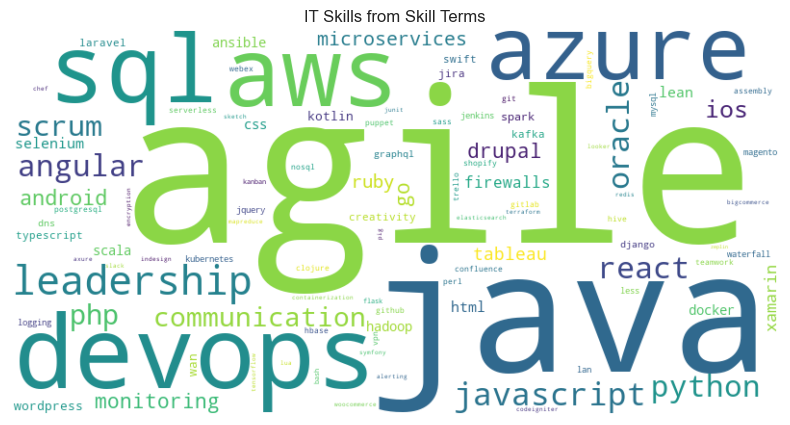

In [44]:
# Concatenate relevant text fields to create a corpus
def prune_words(quote, words):

    # clean text
    soup = bs4.BeautifulSoup(quote, features="html.parser")
    #quote = re.sub("<.*?>|nbsp", "", quote)
    
    for script in soup(["script", "style"]):
        script.extract()

    quote = soup.get_text(separator=" ")
    quote = quote.lower()
    tokens = word_tokenize(quote)
    token_punc = [t for t in tokens if t.isalpha()]
    token_stop = [t for t in token_punc if t not in stop_words]

    text = [w for w in token_stop if w in words]


    return ' '.join(text)


it_skill_terms = [word.lower() for word in it_skill_terms]

itDf['Skills'] = itDf['Requirement'].dropna().apply(lambda x: prune_words(x, it_skill_terms))



# Initialize TF-IDF vectorizer
vectorizer = TfidfVectorizer(vocabulary=it_skill_terms)

# Vectorize the corpus
X = vectorizer.fit_transform(itDf['Skills'])


# Compute skill occurrences
skill_occurrences = X.sum(axis=0)

# Create a DataFrame to store skill occurrences
skills_df = pd.DataFrame(skill_occurrences.T, index=it_skill_terms, columns=['Occurrences'])

# Sort skills by occurrences in descending order
hot_skills = skills_df[skills_df['Occurrences'] > 0].sort_values(by='Occurrences', ascending=False)
skills_df

# Get data for wordcloud
skills_feature_names = vectorizer.get_feature_names_out()
skills_dict = {}
for word, idx in vectorizer.vocabulary_.items():
    skills_dict[word] = skill_occurrences[0, idx]

skills_wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(skills_dict)
plt.figure(figsize=(10,5))
plt.title("IT Skills from Skill Terms")
plt.imshow(skills_wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [68]:
print(len(hot_skills))
print(hot_skills)

100
                  Occurrences
agile              487.242108
java               422.416323
devops             273.025282
aws                250.732214
sql                237.011379
...                       ...
containerization     0.767535
symfony              0.701052
bigcommerce          0.674027
chef                 0.565368
zeplin               0.465442

[100 rows x 1 columns]


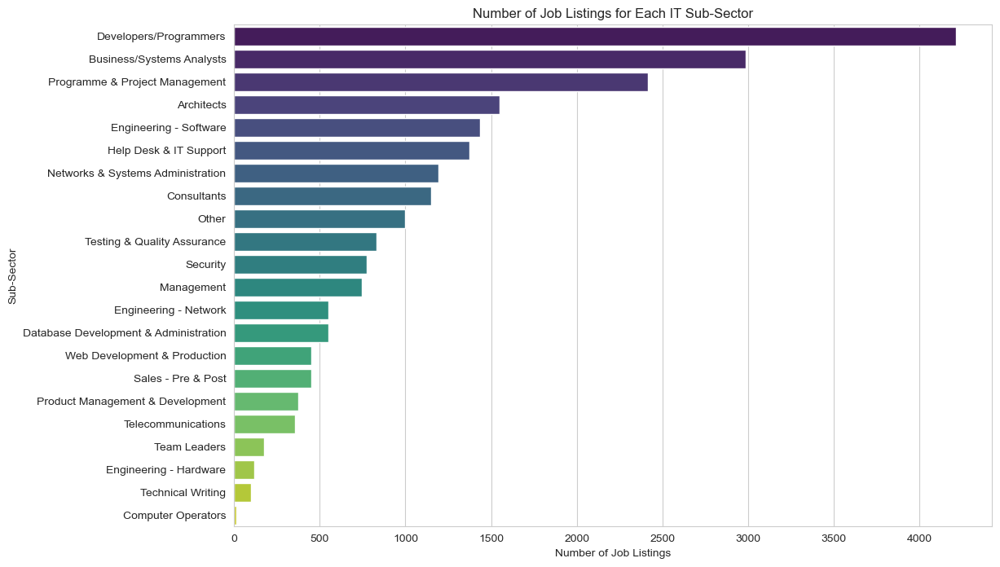

In [69]:
# Calculate the total number of job listings for each SubClassification
subclass_job_counts = itDf['SubClassification'].value_counts()

# Sort the SubClassifications by the total number of job listings
sorted_subclasses = subclass_job_counts.index  # Reverse the order

# Create the vertical bar chart using Seaborn
plt.figure(figsize=(12, 8))
sns.barplot(x=subclass_job_counts.values, y=sorted_subclasses, palette='viridis')

# Set labels and title
plt.xlabel('Number of Job Listings')
plt.ylabel('Sub-Sector')
plt.title('Number of Job Listings for Each IT Sub-Sector')

# Show the plot
plt.show()

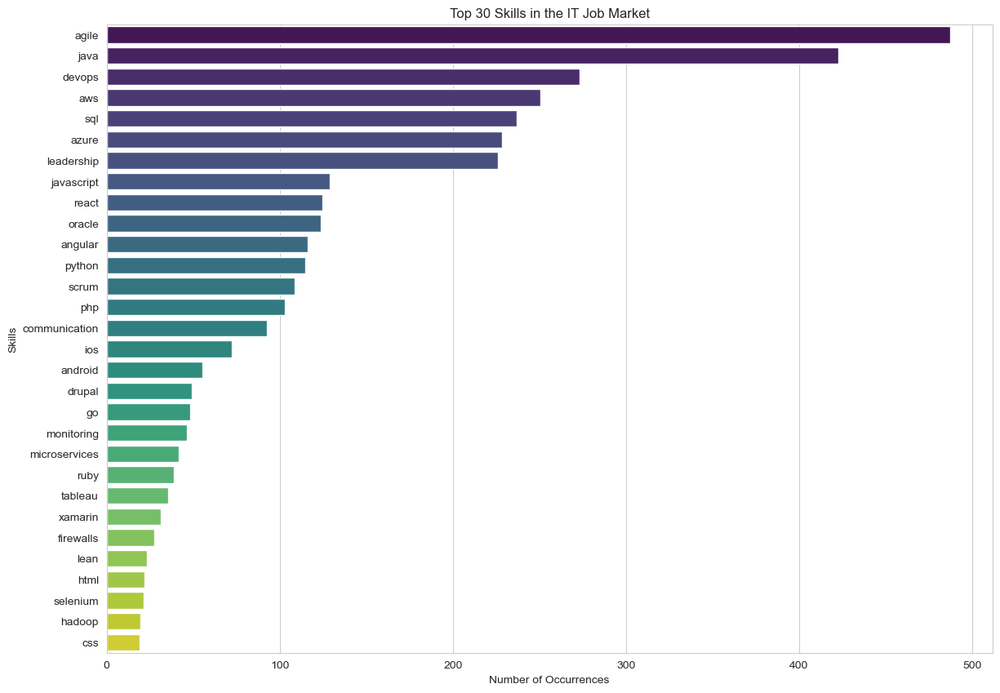

In [70]:
# Extract the top 50 skills
top_30_skills = hot_skills.head(30)

# Create the vertical bar chart using Seaborn
plt.figure(figsize=(14, 10))
sns.barplot(x=top_30_skills['Occurrences'], y=top_30_skills.index, palette='viridis')

# Set labels and title
plt.xlabel('Number of Occurrences')
plt.ylabel('Skills')
plt.title('Top 30 Skills in the IT Job Market')

# Show the plot
plt.show()


In [49]:
# ChatGPT was used to classify the skills into skill categories
skill_categories = {
    'Programming Languages': ['java', 'javascript', 'python', 'php', 'ruby', 'go', 'scala', 'swift', 'typescript', 'kotlin', 'perl', 'clojure', 'assembly', 'bash', 'lua'],
    'Cloud Technologies': ['aws', 'azure', 'gcp', 'google cloud', 'ibm cloud', 'bigquery', 'serverless'],
    'DevOps Tools': ['devops', 'docker', 'kubernetes', 'jenkins', 'ansible', 'puppet', 'terraform', 'chef'],
    'Data Technologies': ['sql', 'mysql', 'postgresql', 'nosql', 'hadoop', 'spark', 'hive', 'hbase', 'pig', 'mapreduce', 'oracle'],
    'Frameworks & Libraries': ['react', 'angular', 'django', 'flask', 'spring', 'tensorflow', 'graphql', 'laravel', 'vue', 'symfony', 'xamarin', 'sass'],
    'Other Technologies': ['git', 'github', 'gitlab', 'jira', 'confluence', 'jira', 'looker', 'woocommerce', 'slack', 'terraform', 'zeplin', 'sketch'],
    'Tools': ['tableau', 'xamarin', 'dns', 'vpn', 'lan', 'wan', 'firewalls', 'encryption', 'terraform', 'redis', 'elasticsearch'],
    'Soft Skills': ['agile', 'leadership', 'scrum', 'communication', 'creativity', 'teamwork', 'kanban', 'less', 'waterfall'],
    'Mobile Development': ['ios', 'android', 'xamarin'],
    'Web Development': ['html', 'css', 'jquery', 'wordpress', 'magento', 'shopify', 'drupal', 'typescript', 'php', 'go', 'ruby', 'laravel', 'wordpress', 'graphql'],
}



def categorize_skill(skill):
    for category, skills in skill_categories.items():
        if skill in skills:
            return category
    return 'Uncategorized'

hot_skills_df = hot_skills.reset_index()
hot_skills_df.columns = ['Skill', 'Occurrences']
hot_skills_df['Category'] = hot_skills_df['Skill'].apply(categorize_skill)

# Calculate the number of skills in each category and the sum of occurrences
category_counts = hot_skills_df['Category'].value_counts()
category_occurrences = hot_skills_df.groupby('Category')['Occurrences'].sum()

# Create a DataFrame for plotting
plot_df = pd.DataFrame({
    'Number of Skills': category_counts,
    'Total Occurrences': category_occurrences
}).reset_index()
plot_df = plot_df.sort_values(by='Number of Skills', ascending=False)

# Create the interactive bar plot using Plotly
fig = px.bar(plot_df, x='Category', y='Number of Skills', color='Total Occurrences',
             labels={'Number of Skills': 'Number of Skills', 'Total Occurrences': 'Total Occurrences'},
             title='Number of Skills per Category with Occurrences Heatmap',
             color_continuous_scale='viridis')

# Update layout for better visualization
fig.update_layout(xaxis_title='Skill Category', yaxis_title='Number of Skills')

# Show the interactive plot
fig.show()


In [48]:
# Calculate the average occurrences per category
average_occurrences = category_occurrences / category_counts

# Create a DataFrame for plotting
plot_df = pd.DataFrame({
    'Number of Skills': category_counts,
    'Average Occurrences': average_occurrences
}).reset_index().rename(columns={'index': 'Category'})

# Sort the DataFrame by 'Number of Skills'
plot_df = plot_df.sort_values(by='Average Occurrences', ascending=False)

# Create the interactive bar plot using Plotly
fig = px.bar(plot_df, x='Category', y='Average Occurrences', color='Number of Skills',
             labels={'Number of Skills': 'Number of Skills', 'Average Occurrences': 'Average Occurrences'},
             title=' Average Occurrences per Category with Number of Skills per Category Heatmap',
             color_continuous_scale='viridis')

# Update layout for better visualization
fig.update_layout(xaxis_title='Skill Category', yaxis_title='Average Occurrences')

# Show the interactive plot
fig.show()

In [47]:
import plotly.graph_objects as go


# Extract top 10 skills from hot_skills
top_skills = hot_skills.index[:10]

# Initialize a dictionary to store skill occurrences for each SubClassification
skill_occurrences_subclass = {}

# Iterate over unique SubClassifications
for subclass in itDf['SubClassification'].unique():
    # Filter DataFrame by current SubClassification
    subclass_df = itDf[itDf['SubClassification'] == subclass]
    
    # Concatenate all Requirement text for the current SubClassification
    subclass_corpus = ' '.join(subclass_df['Requirement'].dropna())
    
    # Vectorize the corpus using the same vectorizer
    X_subclass = vectorizer.transform([subclass_corpus])
    
    # Compute skill occurrences for the current SubClassification
    skill_occurrences_subclass[subclass] = X_subclass.sum(axis=0)

# Create a DataFrame to store skill occurrences for each SubClassification
heatmap_data = pd.DataFrame(index=itDf['SubClassification'].unique(), columns=top_skills)
for subclass, occurrences in skill_occurrences_subclass.items():
    for skill in top_skills:
        heatmap_data.at[subclass, skill] = occurrences[0, it_skill_terms.index(skill)]


# Calculate the total number of job listings for each SubClassification
subclass_job_counts = itDf['SubClassification'].value_counts()

# Sort the SubClassifications by the total number of job listings
sorted_subclasses = subclass_job_counts.index[::-1]  # Reverse the order

# Create the heatmap figure using Plotly
fig = go.Figure(data=go.Heatmap(
    z=heatmap_data.loc[sorted_subclasses, :].astype(float),
    x=top_skills,
    y=sorted_subclasses,
    colorscale='viridis',
    hoverongaps=False,
    showscale=True,  # Show the color scale
    zmin=0,  # Set the minimum value of the color scale to 0
    zmax=heatmap_data.max().max(),  # Set the maximum value of the color scale to the maximum value in the heatmap
    colorbar=dict(title='Occurrences')  # Customize the color bar title
))

# Customize the layout
fig.update_layout(
    title='Occurrences of Top 10 Skills in Each IT Sub-Sector',
    xaxis=dict(title='Skills', tickangle=45),
    yaxis=dict(title='Sub-Sector'),
    height=1000,  # Adjust the height of the figure
    width=1500  # Adjust the width of the figure
)

# Show the annotations rounded to 2 decimal places with white text color
annotations = []
for i, subclass in enumerate(sorted_subclasses):
    for j, skill in enumerate(top_skills):
        annotations.append(dict(x=skill, y=subclass, text=str(round(heatmap_data.at[subclass, skill], 2)), showarrow=False, font=dict(color='white')))

fig.update_layout(annotations=annotations)

# Show the interactive heatmap
fig.show()



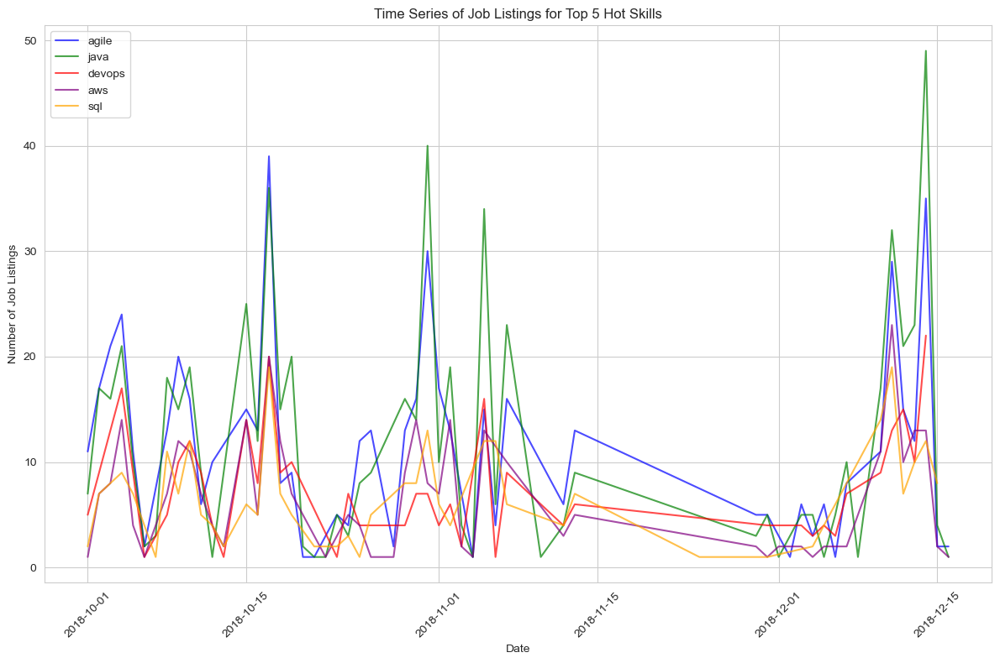

In [50]:
# Get the top 5 hot skills
top_5_skills = hot_skills.index[:5]

# Initialize a figure
plt.figure(figsize=(12, 8))
colors = ['blue', 'green', 'red', 'purple', 'orange']



# Iterate over each top 5 hot skill
for i, skill in enumerate(top_5_skills):
    # Filter the DataFrame to include only rows containing the current skill
    skill_df = itDf[itDf['Skills'].str.contains(skill, case=False, na=False)]
    
    # Group by date and count the number of job listings for each date
    job_counts = skill_df.groupby('Date').size()
    color = colors[i]
    # Plot a time series for the current skill
    plt.plot(job_counts.index, job_counts.values, label=skill, alpha=0.7, color = color)

# Add labels and legend
plt.title('Time Series of Job Listings for Top 5 Hot Skills')
plt.xlabel('Date')
plt.ylabel('Number of Job Listings')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()


#### __OBSERVATIONS__

The first attempt to extract information regarding hot skills in the market used TFIDF was performed on all IT requirements and then frequencies were plotted in a wordcloud. The stop words were tweaked in attempt to remove words that did not increase understanding of the dataset, but without significant tweaking, this method was not helpful in understanding what technical skills are hot in the IT sector for this dataset. After this, clustering was performed on the IT job titles to attempt to discern most popular jobs in the IT sector. Setting ngram range to (1, 3) allowed full role titles like 'Technical Support Engineer' to be grouped into similar clusters (like cluster 3). PCA/Dimensionality reduction was attempted but took too long to run on the machine this analaysis was performed on and was thus discarded. The top term for each cluster was, from cluster 0 to cluster 4: develop, manag, busi analyst, engin, and support. The relationship between job titles and their cluster aligned with the top 5 most popular IT sub-sectors, suggesting the information found with clustering in this context was similar to the information presented in that category of the data. Clustering may be more useful to find information regarding specific sub-sectors or potentially to cluster the skills jobs require.

Finally, a list of skills was generated from ChatGPT using prompt ```give me a large list of skill terms relevant to the current IT job market in a format I can copy in as a python list``` and following up with ```make it larger and include more technical things```. Then, the list was converted to a set and back to a list again to remove duplicate terms, and finally converted to lowercase. This was used as a filter for the ```'Requirement'``` column of ```itDf``` in order to get a greater understanding of the skills. Manually using a list like this is subject to bias and exclusion, and also does not account well for skills that are more than one word, but it provided the most information regarding what technical skills are trending in the market relative to other attempts.

#### __ANALYSIS__

The 'IT Skills from Skill Terms' wordcloud showed 'agile' and 'java' as the largest terms, but other terms were only slightly smaller. The results of this wordcloud were much different to the results from the 'IT Requirements' wordcloud, and places much greater emphasis on technical skills. The skills TF-IDF results were used to determine the top 10 skills in the IT sector. Java and Javascript are the only programming languages which made it in the top 10, which is surprising as developers/programmers is the sub-sector with the most listings. This prompted using chatGPT to categorize the skills from hot_skills, with prompt ```Make categories for these skills``` and copying in the hot_skills series. These categories are therefore not infalliable and are also subject to bias, but they do seem to provide decent insight into the data. 

The 'Number of Skills per Category with Occurrences Heatmap' shows that the Programming Languages category containes the largest number of skills (15) and the second most occurances (~917), second to Soft Skills which has ~940 occurances. Soft Skills' large number of occurrences should not be surprising as methadologies which can be broadly applied across the IT industry such as 'agile' and 'scrum' are included in this category. Programming Languages as the standout category aids in understanding why Developers/Programmers is the sub-sector with the greatest number of listings, despite only 2 programming languages being included in the top 10 skills list. 

A second plot, 'Average Occurrences per Category with Number of Skills per Category Heatmap' aims to show the relative weight/value of each skill in each category. This information can be used to determine what category has skills which provide the most 'bang for buck' to develop. According to this interpretation, the Cloud Technologies category's average occurances is ~121, which is the highest. This means developing one Cloud Technology skill may be worth many Data Technologies skills, which have average occurrences = ~37.

The 'Occurrences of Top 10 Skills in Each IT Sub-Sector' heatmap is useful for determining what skills are prominent in what sub-sector. This heatmap shows that for the most part, the top 10 skills are relatively dispersed across the sub-sectors, indicating IT is a sector requiring a broad domain of knowledge. The least broad sector by far was Computer Operators, which only had devops as a skill, but this is likely due to a lack of data for Computer Operators. The same can be said for Technical Writing.

A time series was made to determine if any market trends occurred in the time period of the job listings, but nothing was observed. This is likely due to the short time domain of the data.



___

___
# 4) Interactive Visulisations
___

More indepth interactive visulisations of the above topics

_Number of Jobs Visulization by Location_

In [75]:
data = []
df2 = df.fillna("unknown")
for location in locationDf["Location"][:20]:
    for area in df2[df2["Location"] == location]["Area"].unique():
        data.append([location, area])

areaMapDf = pd.DataFrame(data=data, columns=["Location", "Area"])

In [76]:

data = []
for day in dayDf.loc["2018-10-01":"2018-12-16"].index:
    dayDf2 = df[df["Date"] == day]
    dayDf2 = dayDf2.fillna("unknown")
    for location in locationDf["Location"][:20]:
        if location in dayDf2["Location"].unique():
            areaDf = dayDf2[dayDf2["Location"] == location].groupby(by="Area").count()
            areaDf.fillna("unknown")
            for area in areaMapDf[areaMapDf["Location"] == location]["Area"].unique():
                if area in areaDf.index:
                    data.append([day, areaDf.loc[area, "Id"], location, area])
                else:
                    data.append([day, 0, location, area])
        else:
            for area in areaMapDf[areaMapDf["Location"] == location]["Area"].unique():
                data.append([day, 0, location, area])
                
dfTest = pd.DataFrame(data=data, columns=["Date", "Count", "Location", "Area"])

In [77]:
px.bar(data_frame=dfTest, x="Location", y="Count", animation_frame="Date",category_orders=locationDf["Location"][:20], range_y=[1, 4000], hover_name="Area", color="Area", title="Number of Job Listings vs Location over Time")

In [78]:
px.bar(data_frame=dfTest, x="Location", y="Count", animation_frame="Date",category_orders=locationDf["Location"][:20], log_y=True, range_y=[1, 4000], hover_name="Area", color="Area", title="Logarithmic Number of Job Listings vs Location over Time")

_Number of Jobs Visulization by Sector_

In [79]:
data = []
df2 = df.fillna("unknown")
for sector in sectorDf["Classification"][:5]:
    for subsector in df2[df2["Classification"] == sector]["SubClassification"].unique():
        data.append([sector, subsector])

subsectorMapDf = pd.DataFrame(data=data, columns=["Classification", "SubClassification"])

In [80]:
data = []
for day in dayDf.loc["2018-10-01":"2018-12-16"].index:
    dayDf2 = df[df["Date"] == day]
    dayDf2 = dayDf2.fillna("unknown")
    for sector in sectorDf["Classification"][:5]:
        if sector in dayDf2["Classification"].unique():
            subsectorDf = dayDf2[dayDf2["Classification"] == sector].groupby(by="SubClassification").count()
            subsectorDf.fillna("unknown")
            for subsector in subsectorMapDf[subsectorMapDf["Classification"] == sector]["SubClassification"].unique():
                if subsector in subsectorDf.index:
                    data.append([day, subsectorDf.loc[subsector, "Id"], sector, subsector])
                else:
                    data.append([day, 0, sector, subsector])
        else:
            for subsector in subsectorMapDf[subsectorMapDf["Classification"] == sector]["SubClassification"].unique():
                data.append([day, 0, sector, subsector])
                
dfTest = pd.DataFrame(data=data, columns=["Date", "Count", "Classification", "SubClassification"])

In [81]:
px.bar(data_frame=dfTest, y="Classification", x="Count", category_orders=sectorDf["Classification"][:5], animation_frame="Date", range_x=[1, 1500], hover_name="SubClassification", color="SubClassification", title="Number of Job Listings vs Sector over Time")

_Finding the necessesary skills for the IT sector_

In [82]:
stemmer = nltk.stem.PorterStemmer()
lemmatizer = nltk.stem.WordNetLemmatizer()


def clean_data(quote):
    soup = bs4.BeautifulSoup(quote, features="html.parser")
    #quote = re.sub("<.*?>|nbsp", "", quote)
    for script in soup(["script", "style"]):
        script.extract()

    quote = soup.get_text(separator=" ")
    quote = quote.lower()
    tokens = word_tokenize(quote)
    token_punc = [t for t in tokens if t.isalpha()]
    token_stop = [t for t in token_punc if t not in stop_words]
    stemmed_words = [stemmer.stem(w) for w in token_stop]
    return stemmed_words

In [83]:
stop_words = stopwords.words("english")

itDfDesciption = itDf[itDf["FullDescription"].notna()]
itDfDesciption["token"] = itDfDesciption["FullDescription"].apply(lambda x: clean_data(x))

C:\Users\jmere\AppData\Local\Temp\ipykernel_6104\3455030043.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [84]:
# Create a corpus
corpus = itDfDesciption['token']

# Compute the dictionary: this is a dictionary mapping words and their corresponding numbers for later visualisation
id2word = Dictionary(corpus)

# Create a BOW
bow = [id2word.doc2bow(line) for line in corpus]  # convert corpus to BoW format

In [85]:
# Fit a TF-IDF
tfidf_model = TfidfModel(bow)

# Compute the TF-IDF
tf_idf_gensim = tfidf_model[bow]

In [86]:
lda = LdaModel(corpus=tf_idf_gensim, id2word=id2word, num_topics=4, passes=15, random_state=0)

In [87]:
import pyLDAvis
import pyLDAvis.gensim_models

pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(topic_model=lda, corpus=bow, dictionary=id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3      0.215938  0.030278       1        1  64.602539
1      0.143744  0.000285       2        1  31.439251
0     -0.140660 -0.169380       3        1   2.412581
2     -0.219022  0.138818       4        1   1.545629, topic_info=               Term          Freq         Total Category  logprob  loglift
71          network   4271.000000   4271.000000  Default  30.0000  30.0000
518           secur  11819.000000  11819.000000  Default  29.0000  29.0000
483   infrastructur   5928.000000   5928.000000  Default  28.0000  28.0000
335            test  10538.000000  10538.000000  Default  27.0000  27.0000
537           autom   3881.000000   3881.000000  Default  26.0000  26.0000
...             ...           ...           ...      ...      ...      ...
34            engin    238.587370   5183.292987   Topic4  -5.5452   1.0913
1052        virtual    167.481096    701.391338   Topic4  -5.8991   2.7375
355       administr    203.779765   3435.794428   Topic4  -5.7029   1.3448
518           secur    215.922354  11819.529493   Topic4  -5.6450   0.1671
68        microsoft    185.121729   4868.830716   Topic4  -5.7989   0.9001

[310 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
5165      1  0.992123      abap
5165      2  0.003945      abap
5165      3  0.001972      abap
5165      4  0.000986      abap
130       1  0.779434      abil
...     ...       ...       ...
1249      4  0.495828  wireless
1694      1  0.040226   xamarin
1694      2  0.028733   xamarin
1694      3  0.925209   xamarin
1694      4  0.005747   xamarin

[1092 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 2, 1, 3])

#### __ANALYSIS__
An LDA model was trained and visulised using 4 topics on the IT sector's full desciption.  Topics 1 & 2 were similar (demonstrated by the close distance on the graph), these topic were also the largest in size. These two topic generally focused on general IT soft skills such as teamwork, analysis and management. Topic 3 was much smaller in size, this topic was much more specific however and focused on Technologies and Programmming Languages. Some terms in this topic include javascript, react, python and c. The last topic was number 4 and had a similar size to that of number 3. This topic also had a much greater focus and was all about IT infrastructure. Some terms from this topic inclde Linux, server, router, vmware and cisco.

If a stakeholder needed to know what skills were neccesary for IT then these topics could be used as a general guide. For broad but general IT skills topics 1 and 2 can be used such as teamwork or product managment. For must know frameworks and languages topic 3 could be used to know what currently is being hired for in the industry such as jaascript and react. Finally, for infrastructure and implementation skills, terms in topic 4 can be used as a guide for what to know such as a server and linux.

___